In [2]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
import tensorflow as tf
from tensorflow import keras
import os
import glob
import traceback

# GPU Configuration
physical_devices = tf.config.list_physical_devices('GPU')
print(f"Num GPUs Available: {len(physical_devices)}")
if len(physical_devices) > 0:
    for gpu in physical_devices:
        tf.config.experimental.set_memory_growth(gpu, True)
    print("GPU memory growth enabled")

    # Create a MirroredStrategy for multi-GPU support (if available)
    strategy = tf.distribute.MirroredStrategy()
    print(f"Using strategy: MirroredStrategy with {strategy.num_replicas_in_sync} replicas")
else:
    print("No GPU detected, using CPU")
    strategy = tf.distribute.get_strategy()

# Force TensorFlow to use GPU
if len(physical_devices) > 0:
    print("Setting device placement to GPU...")
    tf.config.set_visible_devices(physical_devices, 'GPU')

# Print device placement for operations
print("TensorFlow operations will run on:", tf.config.list_logical_devices())


Num GPUs Available: 1
GPU memory growth enabled
INFO:tensorflow:Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0',)
Using strategy: MirroredStrategy with 1 replicas
Setting device placement to GPU...
TensorFlow operations will run on: [LogicalDevice(name='/device:CPU:0', device_type='CPU'), LogicalDevice(name='/device:GPU:0', device_type='GPU')]


I0000 00:00:1746517552.804052    1244 gpu_device.cc:2019] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 21458 MB memory:  -> device: 0, name: NVIDIA GeForce RTX 4090, pci bus id: 0000:01:00.0, compute capability: 8.9


In [3]:
IMG_WIDTH, IMG_HEIGHT = 128, 128
BATCH_SIZE = 32
EPOCHS = 20
INPUT_SHAPE = (IMG_WIDTH, IMG_HEIGHT, 3)
NUM_CLASSES = 1

In [4]:
def is_valid_image(file_path):
    try:
        with tf.io.gfile.GFile(file_path, 'rb') as f:
            img_data = f.read()
        tf.image.decode_image(img_data)
        return True
    except: return False

def filter_valid_images(image_paths):
    valid_images = []
    for img_path in tqdm(image_paths, desc="Validating images"):
        if is_valid_image(img_path): valid_images.append(img_path)
    print(f"Filtered {len(image_paths)-len(valid_images)} invalid images")
    return valid_images

def verify_data_paths(train_dir, validation_dir):
    for directory in [train_dir, validation_dir]:
        if not os.path.exists(directory):
            raise ValueError(f"Missing directory: {directory}")
        subdirs = [d for d in os.listdir(directory) if os.path.isdir(os.path.join(directory, d))]
        if not subdirs: raise ValueError(f"No classes in {directory}")
        print(f"Found {len(subdirs)} classes in {directory}")
    return True

def create_safe_tf_dataset(directory, is_training=False):
    """Create a safe TensorFlow dataset that handles errors gracefully"""
    def process_path(file_path, label):
        """Process a single image file path"""
        try:
            # Read the image file
            image = tf.io.read_file(file_path)

            # Use generic image decoder that handles all formats
            image = tf.image.decode_image(image, channels=3, expand_animations=False)
            
            # Convert to float and normalize
            image = tf.image.convert_image_dtype(image, tf.float32)

            # Resize
            image = tf.image.resize(image, [IMG_WIDTH, IMG_HEIGHT])

            # Data augmentation for training
            if is_training:
                image = tf.image.random_flip_left_right(image)
                image = tf.image.random_brightness(image, max_delta=0.1)
                image = tf.image.random_contrast(image, lower=0.9, upper=1.1)

            return image, label
        except Exception as e:
            print(f"Error processing image {file_path}: {e}")
            return tf.zeros([IMG_WIDTH, IMG_HEIGHT, 3], dtype=tf.float32), label

    # Get all image files and labels
    classes = sorted(os.listdir(directory))  # FIXED: Removed extra parenthesis
    class_to_idx = {cls_name: i for i, cls_name in enumerate(classes)}

    image_paths = []
    labels = []

    for cls_name in classes:
        cls_dir = os.path.join(directory, cls_name)
        if not os.path.isdir(cls_dir):
            continue

        cls_idx = class_to_idx[cls_name]
        cls_images = glob.glob(os.path.join(cls_dir, "*.jpg")) + \
                     glob.glob(os.path.join(cls_dir, "*.jpeg")) + \
                     glob.glob(os.path.join(cls_dir, "*.png"))

        valid_images = filter_valid_images(cls_images)
        image_paths.extend(valid_images)
        labels.extend([cls_idx] * len(valid_images))

    if not image_paths:
        raise ValueError(f"No valid images found in {directory}")



    samples = len(image_paths)

    # Create TensorFlow dataset with error handling
    dataset = tf.data.Dataset.from_tensor_slices((
        tf.constant(image_paths),
        tf.constant(labels, dtype=tf.float32)  # Binary classification
    ))

    # Map the processing function
    dataset = dataset.map(process_path,
                          num_parallel_calls=tf.data.experimental.AUTOTUNE)

    # Set output shapes
    dataset = dataset.map(
        lambda x, y: (
            tf.ensure_shape(x, [IMG_WIDTH, IMG_HEIGHT, 3]),
            tf.ensure_shape(y, [])
        )
    )

    # Shuffle training data
    if is_training:
        dataset = dataset.shuffle(buffer_size=min(samples, 10000))

    # Apply batching and prefetching
    dataset = dataset.batch(BATCH_SIZE, drop_remainder=False)
    dataset = dataset.prefetch(tf.data.experimental.AUTOTUNE)

    return dataset, samples

def create_fallback_dataset(directory, is_training=False):
    """Create dataset using Keras ImageDataGenerator as fallback"""
    from tensorflow.keras.preprocessing.image import ImageDataGenerator

    print("Using fallback ImageDataGenerator approach...")

    if is_training:
        datagen = ImageDataGenerator(
            rescale=1./255,
            rotation_range=20,
            width_shift_range=0.1,
            height_shift_range=0.1,
            shear_range=0.1,
            zoom_range=0.1,
            horizontal_flip=True,
            fill_mode='nearest',
            validation_split=0.0
        )
    else:
        datagen = ImageDataGenerator(rescale=1./255)

    generator = datagen.flow_from_directory(
        directory,
        target_size=(IMG_WIDTH, IMG_HEIGHT),
        batch_size=BATCH_SIZE,
        class_mode='binary',
        shuffle=is_training
    )

    # Convert to tf.data.Dataset
    def gen_wrapper():
        for x, y in generator:
            yield x, y

    output_types = (tf.float32, tf.float32)
    output_shapes = (
        tf.TensorShape([None, IMG_WIDTH, IMG_HEIGHT, 3]),
        tf.TensorShape([None])
    )

    dataset = tf.data.Dataset.from_generator(
        gen_wrapper,
        output_types=output_types,
        output_shapes=output_shapes
    )

    # Add prefetching for performance
    dataset = dataset.prefetch(tf.data.experimental.AUTOTUNE)

    return dataset, generator.samples



In [5]:
def create_model(input_shape=(128, 128, 3)):
    """Create a CNN model for binary classification with multiple convolutional blocks"""
    
    # Handle input shape validation
    if not (isinstance(input_shape, tuple) and len(input_shape) == 3):
        print(f"Warning: Invalid input shape {input_shape}, using default")
        input_shape = (128, 128, 3)
    
    model = keras.models.Sequential([
        # First Convolutional Block
        keras.layers.Conv2D(16, (3, 3), padding='same', input_shape=input_shape),
        keras.layers.Activation('relu'),
        keras.layers.Conv2D(32, (3, 3), padding='same'),
        keras.layers.Activation('relu'),
        keras.layers.MaxPooling2D(pool_size=(2, 2)),
        keras.layers.Dropout(0.2),
        keras.layers.BatchNormalization(),
        
        # Second Convolutional Block
        keras.layers.Conv2D(64, (3, 3), padding='same'),
        keras.layers.Activation('relu'),
        keras.layers.Conv2D(64, (3, 3), padding='same'),
        keras.layers.Activation('relu'),
        keras.layers.MaxPooling2D(pool_size=(2, 2)),
        keras.layers.Dropout(0.25),
        keras.layers.BatchNormalization(),
        
        # Third Convolutional Block
        keras.layers.Conv2D(128, (3, 3), padding='same'),
        keras.layers.Activation('relu'),
        keras.layers.MaxPooling2D(pool_size=(2, 2)),
        keras.layers.Dropout(0.3),
        keras.layers.BatchNormalization(),
        
        # Fourth Convolutional Block
        keras.layers.Conv2D(256, (3, 3), padding='same'),
        keras.layers.Activation('relu'),
        keras.layers.MaxPooling2D(pool_size=(2, 2)),
        keras.layers.Dropout(0.35),
        keras.layers.BatchNormalization(),
        
        # Fifth Convolutional Block
        keras.layers.Conv2D(512, (3, 3), padding='same'),
        keras.layers.Activation('relu'),
        keras.layers.MaxPooling2D(pool_size=(2, 2)),
        keras.layers.Dropout(0.5),
        keras.layers.BatchNormalization(),
        
        # Fully Connected Layers
        keras.layers.Flatten(),
        keras.layers.Dense(128, activation='relu'),
        keras.layers.Dropout(0.5),
        keras.layers.Dense(1, activation='sigmoid')
    ])
    
    # Compile the model with Adam optimizer and binary cross-entropy loss
    model.compile(
        loss='binary_crossentropy',
        optimizer=keras.optimizers.Adam(learning_rate=0.001),
        metrics=['accuracy']
    )
    
    return model

In [28]:
def plot_learning_curves(history):
    """Plot learning curves for loss and accuracy."""
    plt.figure(figsize=(12, 5))

    # Plot loss curves
    plt.subplot(1, 2, 1)
    plt.plot(history.history['loss'], label='Train')
    plt.plot(history.history['val_loss'], label='Validation')
    plt.title('Loss Curve')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()

    # Plot accuracy curves
    plt.subplot(1, 2, 2)
    plt.plot(history.history['accuracy'], label='Train')
    plt.plot(history.history['val_accuracy'], label='Validation')
    plt.title('Accuracy Curve')
    plt.xlabel('Epochs')
    plt.ylabel('Accuracy')
    plt.legend()

    plt.tight_layout()
    plt.show()

def plot_sample_predictions(dataset, model, class_names, n=16):
    """Plot sample predictions for model evaluation"""
    try:
        # Get a batch of data
        for images, labels in dataset.take(1):
            break

        # Handle cases where images might be fewer than n
        batch_size = min(images.shape[0], n)

        if batch_size == 0:
            print("No images available for prediction display")
            return

        # Get predictions
        predictions = model.predict(images)

        # Plot images with predictions
        plt.figure(figsize=(12, 12))
        for i in range(batch_size):
            plt.subplot(4, 4, i+1)
            plt.imshow(images[i])
            plt.grid(False)
            plt.xticks([])
            plt.yticks([])

            true_label = class_names[int(labels[i])]
            pred_label = class_names[int(predictions[i][0] > 0.5)]
            confidence = predictions[i][0] if pred_label == class_names[1] else 1 - predictions[i][0]
            color = 'green' if true_label == pred_label else 'red'

            plt.xlabel(f"True: {true_label}\nPred: {pred_label} ({confidence:.2f})", color=color)

        plt.tight_layout()
        plt.show()
    except Exception as e:
        print(f"Error displaying predictions: {e}")
        traceback.print_exc()

import traceback
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
import matplotlib.pyplot as plt

def generate_confusion_matrix(dataset, model, class_names, samples, batch_size=32):
    """Generate confusion matrix from validation dataset with error handling"""
    try:
        # Collect predictions
        y_true = []
        y_pred = []
        # Calculate steps
        steps = samples // batch_size + (1 if samples % batch_size > 0 else 0)
        print("Generating confusion matrix...")
        for i, (images, labels) in enumerate(dataset.take(steps)):
            # Print progress update every 10% of steps
            if steps > 10 and i % (steps // 10) == 0:
                print(f"Progress: {i}/{steps} batches ({int(i/steps*100)}%)")
            try:
                predictions = model.predict(images, verbose=0)
                y_true.extend(labels.numpy())
                y_pred.extend((predictions > 0.5).flatten())
            except Exception as e:
                print(f"Error processing batch {i}: {e}")
                continue
        
        # Only take up to the number of samples to avoid padding
        y_true = y_true[:samples]
        y_pred = y_pred[:samples]
        
        if len(y_true) == 0 or len(y_pred) == 0:
            print("No valid predictions for confusion matrix")
            return
        
        # Calculate and display confusion matrix
        print(f"Processing complete! Analyzed {len(y_true)} samples.")
        
        # Calculate and display confusion matrix
        cm = confusion_matrix(y_true, y_pred)
        disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_names)
        plt.figure(figsize=(8, 8))
        disp.plot(cmap=plt.cm.Blues)
        plt.title("Confusion Matrix")
        plt.show()
    except Exception as e:
        print(f"Error generating confusion matrix: {e}")
        traceback.print_exc()


def plot_balanced_sample_predictions(model, cat_folder, dog_folder, n_per_class=8):
    """
    Plot sample predictions with balanced examples from both cat and dog classes.
    
    Parameters:
    -----------
    model : tf.keras.Model
        Trained model for making predictions
    cat_folder : str
        Path to folder containing cat images
    dog_folder : str
        Path to folder containing dog images
    n_per_class : int
        Number of images per class to display
    """
    import os
    import numpy as np
    import matplotlib.pyplot as plt
    import tensorflow as tf
    from tensorflow.keras.preprocessing.image import load_img, img_to_array
    import random
    
    class_names = ['cat', 'dog']  # Assuming binary classification
    total_images = n_per_class * 2
    
    # Make sure we have a square grid
    grid_size = int(np.ceil(np.sqrt(total_images)))
    
    # Get file lists from each folder
    try:
        cat_files = [os.path.join(cat_folder, f) for f in os.listdir(cat_folder) 
                    if f.lower().endswith(('.png', '.jpg', '.jpeg'))]
        dog_files = [os.path.join(dog_folder, f) for f in os.listdir(dog_folder) 
                    if f.lower().endswith(('.png', '.jpg', '.jpeg'))]
        
        # Check if we have enough images
        if len(cat_files) < n_per_class or len(dog_files) < n_per_class:
            print(f"Warning: Not enough images in folders. Found {len(cat_files)} cat images and {len(dog_files)} dog images.")
            n_per_class = min(len(cat_files), len(dog_files))
        
        # Randomly select images from each class
        selected_cat_files = random.sample(cat_files, n_per_class)
        selected_dog_files = random.sample(dog_files, n_per_class)
        
        # Combine and shuffle the files
        all_files = selected_cat_files + selected_dog_files
        all_labels = [0] * n_per_class + [1] * n_per_class  # 0 for cat, 1 for dog
        
        # Shuffle with the same seed for both lists
        combined = list(zip(all_files, all_labels))
        random.shuffle(combined)
        all_files, all_labels = zip(*combined)
        
        # Load and preprocess images
        images = []
        img_size = model.input_shape[1:3]  # Get expected input size from model
        
        for file_path in all_files:
            try:
                # Load and resize the image
                img = load_img(file_path, target_size=img_size)
                img_array = img_to_array(img)
                
                # Normalize pixel values
                img_array = img_array / 255.0
                images.append(img_array)
            except Exception as e:
                print(f"Error loading image {file_path}: {e}")
                continue
        
        # Convert to numpy arrays
        images = np.array(images)
        labels = np.array(all_labels)
        
        # Get predictions
        predictions = model.predict(images)
        
        # Plot images with predictions
        plt.figure(figsize=(15, 15))
        for i in range(len(images)):
            plt.subplot(grid_size, grid_size, i+1)
            plt.imshow(images[i])
            plt.grid(False)
            plt.xticks([])
            plt.yticks([])
            
            true_label = class_names[int(labels[i])]
            pred_label = class_names[int(predictions[i][0] > 0.5)]
            confidence = predictions[i][0] if pred_label == class_names[1] else 1 - predictions[i][0]
            color = 'green' if true_label == pred_label else 'red'
            
            plt.xlabel(f"True: {true_label}\nPred: {pred_label} ({confidence:.2f})", color=color)
        
        plt.tight_layout()
        plt.show()
        
        # Print summary statistics
        correct = sum(1 for i in range(len(images)) if class_names[int(labels[i])] == class_names[int(predictions[i][0] > 0.5)])
        print(f"Accuracy on these samples: {correct/len(images):.2%}")
        
        # Show class-specific accuracy
        cat_correct = sum(1 for i in range(len(images)) if labels[i] == 0 and predictions[i][0] <= 0.5)
        cat_total = sum(1 for i in range(len(images)) if labels[i] == 0)
        dog_correct = sum(1 for i in range(len(images)) if labels[i] == 1 and predictions[i][0] > 0.5)
        dog_total = sum(1 for i in range(len(images)) if labels[i] == 1)
        
        print(f"Cat accuracy: {cat_correct/cat_total:.2%}")
        print(f"Dog accuracy: {dog_correct/dog_total:.2%}")
    
    except Exception as e:
        import traceback
        print(f"Error displaying predictions: {e}")
        traceback.print_exc()


def visualize_feature_maps(image, model, class_names=None, true_label=None):
    """Visualize feature maps showing how the image changes after each layer."""
    import numpy as np
    import matplotlib.pyplot as plt
    import tensorflow as tf
    from tensorflow import keras
    
    # Reshape image for model input (add batch dimension)
    input_image = np.expand_dims(image, axis=0)
    
    # Get all layer names in the model
    layer_names = [layer.name for layer in model.layers]
    
    # Create feature extraction models for each layer
    feature_models = []
    for layer_name in layer_names:
        try:
            feature_model = keras.Model(inputs=model.inputs, outputs=model.get_layer(layer_name).output)
            feature_models.append((feature_model, layer_name))
        except:
            continue
    
    # Display original image
    plt.figure(figsize=(6, 6))
    plt.imshow(image)
    plt.title("Original Image")
    if true_label is not None and class_names is not None:
        plt.xlabel(f"True label: {class_names[int(true_label)]}")
    plt.axis('off')
    plt.show()
    
    # For each convolutional and pooling layer
    for feature_model, name in feature_models:
        if 'conv' in name or 'pooling' in name:
            # Get feature maps
            feature_maps = feature_model.predict(input_image)
            
            # Handle different output shapes
            if len(feature_maps.shape) == 4:
                n_filters = feature_maps.shape[-1]
                size = feature_maps.shape[1]
                
                # Create a grid of feature maps
                n_cols = 8
                n_rows = int(np.ceil(n_filters / n_cols))
                plt.figure(figsize=(20, 2*n_rows))
                plt.suptitle(f"Feature Maps after {name} - {size}x{size}x{n_filters}", y=1.05)
                for i in range(n_filters):
                    plt.subplot(n_rows, n_cols, i+1)
                    plt.imshow(feature_maps[0, :, :, i], cmap='viridis')
                    plt.axis('off')
                plt.tight_layout()
                plt.show()
                
                # Create a kernel size image with mean across filters
                # Calculate the mean activation at each spatial position across all filters
                spatial_mean = np.mean(feature_maps[0], axis=2)
                
                plt.figure(figsize=(8, 8))
                plt.imshow(spatial_mean, cmap='viridis')
                plt.colorbar(label='Mean Activation')
                plt.title(f"Mean Activation Across All Filters at Each Spatial Position - {name}")
                plt.axis('on')  # Show axes to see the spatial dimensions
                plt.grid(False)
                
                # Add text annotations showing the mean value at each position
                if size <= 16:  # Only add text for reasonably sized feature maps
                    for i in range(size):
                        for j in range(size):
                            value = spatial_mean[i, j]
                            plt.text(j, i, f"{value:.2f}", 
                                    ha="center", va="center", 
                                    color="white" if value < np.max(spatial_mean)/1.5 else "black",
                                    fontsize=8)
                
                plt.tight_layout()
                plt.show()
def visualize_class_means_from_folders(model, class_folders, num_per_class=10, layer_names=None):
    """
    Visualize the mean activation across images loaded directly from folders for each class.
    
    Parameters:
    -----------
    model : tf.keras.Model
        The model to extract feature maps from
    class_folders : dict
        Dictionary mapping class names to folder paths
        Example: {'cat': '/path/to/cats', 'dog': '/path/to/dogs'}
    num_per_class : int
        Number of images to process per class
    layer_names : list or None
        List of specific layer names to analyze. If None, uses all conv/pooling layers.
    """
    import os
    import numpy as np
    import tensorflow as tf
    import matplotlib.pyplot as plt
    from collections import defaultdict
    from tensorflow.keras.preprocessing.image import load_img, img_to_array
    import random
    
    # If no specific layers are provided, get all conv and pooling layers
    if layer_names is None:
        layer_names = [layer.name for layer in model.layers 
                      if ('conv' in layer.name or 'pooling' in layer.name)]
    
    # Create feature extraction models for the specified layers
    feature_models = {}
    for layer_name in layer_names:
        try:
            feature_model = tf.keras.Model(inputs=model.inputs, 
                                          outputs=model.get_layer(layer_name).output)
            feature_models[layer_name] = feature_model
        except Exception as e:
            print(f"Could not create feature model for layer {layer_name}: {e}")
    
    # Dictionaries to store accumulated feature maps by class
    class_accumulated_maps = defaultdict(lambda: {name: None for name in feature_models.keys()})
    class_counts = defaultdict(int)
    
    img_size = model.input_shape[1:3]  # Get expected input size from model
    
    # Process each class folder
    for class_idx, (class_name, folder) in enumerate(class_folders.items()):
        print(f"\nProcessing class: {class_name}")
        
        # Get image files
        files = [os.path.join(folder, f) for f in os.listdir(folder) 
                if f.lower().endswith(('.png', '.jpg', '.jpeg'))]
        
        if len(files) < num_per_class:
            print(f"  Warning: Only found {len(files)} images for {class_name}")
            selected_files = files
        else:
            selected_files = random.sample(files, num_per_class)
        
        print(f"  Processing {len(selected_files)} images...")
        
        # Process each image
        for i, file_path in enumerate(selected_files):
            if i % 5 == 0:
                print(f"  Processing image {i+1}/{len(selected_files)}")
                
            try:
                # Load and preprocess image
                img = load_img(file_path, target_size=img_size)
                img_array = img_to_array(img)
                img_array = img_array / 255.0  # Normalize
                
                # Add batch dimension
                input_image = np.expand_dims(img_array, axis=0)
                
                # Process each layer
                for name, feature_model in feature_models.items():
                    feature_map = feature_model.predict(input_image, verbose=0)
                    
                    # Initialize or accumulate
                    if class_accumulated_maps[class_name][name] is None:
                        class_accumulated_maps[class_name][name] = feature_map
                    else:
                        class_accumulated_maps[class_name][name] += feature_map
                
                class_counts[class_name] += 1
                
            except Exception as e:
                print(f"  Error processing {file_path}: {e}")
    
    # Calculate means and visualize
    for name in layer_names:
        if name not in feature_models:
            continue
            
        class_means = {}
        for class_name, accumulated in class_accumulated_maps.items():
            if accumulated[name] is not None and class_counts[class_name] > 0:
                class_mean = accumulated[name] / class_counts[class_name]
                # Get spatial mean across filters for visualization
                class_means[class_name] = np.mean(class_mean[0], axis=2)
        
        # Skip if no valid means
        if not class_means:
            print(f"No valid results for layer {name}")
            continue
            
        # Plot mean activation heatmaps for each class
        plt.figure(figsize=(15, 5 * len(class_means)))
        plt.suptitle(f"Class-specific Mean Activations - Layer: {name}", fontsize=16, y=0.98)
        
        reference_class = list(class_means.keys())[0]  # Use first class as reference
        
        for i, (class_name, mean_map) in enumerate(class_means.items()):
            # Plot the class mean activation
            plt.subplot(len(class_means), 2, i*2+1)
            im = plt.imshow(mean_map, cmap='hot')
            plt.colorbar(im)
            plt.title(f"{class_name} (n={class_counts[class_name]})")
            plt.grid(True, color='white', linestyle='-', linewidth=0.5, alpha=0.3)
            
            # Plot difference from reference class (except for reference class itself)
            if class_name != reference_class:
                plt.subplot(len(class_means), 2, i*2+2)
                diff_map = mean_map - class_means[reference_class]
                vmax = max(abs(np.min(diff_map)), abs(np.max(diff_map)))
                im = plt.imshow(diff_map, cmap='coolwarm', vmin=-vmax, vmax=vmax)
                plt.colorbar(im)
                plt.title(f"Difference: {class_name} vs {reference_class}")
                plt.grid(True, color='white', linestyle='-', linewidth=0.5, alpha=0.3)
        
        plt.tight_layout()
        plt.subplots_adjust(top=0.95)
        plt.show()
        
        # Create comparison grid of all individual filters for the first layer only
        if name == layer_names[0]:
            # Get the filter dimensions
            n_filters = 0
            filter_size = 0
            for class_name in class_accumulated_maps:
                if class_accumulated_maps[class_name][name] is not None:
                    class_mean = class_accumulated_maps[class_name][name] / class_counts[class_name]
                    if len(class_mean.shape) == 4:
                        n_filters = class_mean.shape[-1]
                        filter_size = class_mean.shape[1]
                        break
            
            if n_filters > 0:
                # Choose a subset of filters to display
                filters_to_show = min(8, n_filters)
                
                plt.figure(figsize=(15, 4 * len(class_means)))
                plt.suptitle(f"Individual Filter Comparison - Layer: {name}", fontsize=16, y=0.98)
                
                # For each filter index
                for filter_idx in range(filters_to_show):
                    for i, class_name in enumerate(class_means.keys()):
                        plt.subplot(filters_to_show, len(class_means), filter_idx*len(class_means) + i + 1)
                        
                        # Get the mean feature map for this class
                        class_mean = class_accumulated_maps[class_name][name] / class_counts[class_name]
                        filter_map = class_mean[0, :, :, filter_idx]
                        
                        plt.imshow(filter_map, cmap='viridis')
                        if filter_idx == 0:
                            plt.title(class_name)
                        if i == 0:
                            plt.ylabel(f"Filter {filter_idx+1}")
                        plt.axis('off')
                
                plt.tight_layout()
                plt.subplots_adjust(top=0.95)
                plt.show()

def analyze_cnn_layers(model, dataset, class_names, num_samples=3):
    """Analyze and visualize how images are transformed through CNN layers."""
    import numpy as np
    
    # Get sample images from dataset
    for images, labels in dataset.take(1):
        sample_images = images.numpy()[:num_samples]
        sample_labels = labels.numpy()[:num_samples]
        break
    
    for image, label in zip(sample_images, sample_labels):
        print(f"\n\nAnalyzing image with true label: {class_names[int(label)]}")
        visualize_feature_maps(image, model, class_names, label)
        

In [7]:
train_dir = './preprocess/train'
validation_dir = './preprocess/test'
class_names = ['Cat', 'Dog']

# Verify paths
verify_data_paths(train_dir, validation_dir)

Found 2 classes in ./preprocess/train
Found 2 classes in ./preprocess/test


True

In [8]:
try:
    train_dataset, train_samples = create_safe_tf_dataset(train_dir, is_training=True)
    val_dataset, val_samples = create_safe_tf_dataset(validation_dir)
except Exception as e:
    print(f"Error: {e}, using fallback")
    train_dataset, train_samples = create_fallback_dataset(train_dir, True)
    val_dataset, val_samples = create_fallback_dataset(validation_dir)

print(f"Training samples: {train_samples}\nValidation samples: {val_samples}")

Error: name 'tqdm' is not defined, using fallback
Using fallback ImageDataGenerator approach...
Found 66893 images belonging to 2 classes.
Using fallback ImageDataGenerator approach...
Found 8243 images belonging to 2 classes.
Training samples: 66893
Validation samples: 8243


In [9]:
model = create_model()
model.summary()

/home/chadifares/.local/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                 │ (None, 128, 128, 16)   │           448 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation (Activation)         │ (None, 128, 128, 16)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 128, 128, 32)   │         4,640 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_1 (Activation)       │ (None, 128, 128, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d (MaxPooling2D)    │ (None, 64, 64, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 64, 64, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization             │ (None, 64, 64, 32)     │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_2 (Conv2D)               │ (None, 64, 64, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_2 (Activation)       │ (None, 64, 64, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_3 (Conv2D)               │ (None, 64, 64, 64)     │        36,928 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_3 (Activation)       │ (None, 64, 64, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_1 (MaxPooling2D)  │ (None, 32, 32, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 32, 32, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_1           │ (None, 32, 32, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_4 (Conv2D)               │ (None, 32, 32, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_4 (Activation)       │ (None, 32, 32, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_2 (MaxPooling2D)  │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_2 (Dropout)             │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_2           │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_5 (Conv2D)               │ (None, 16, 16, 256)    │       295,168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_5 (Activation)       │ (None, 16, 16, 256)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_3 (MaxPooling2D)  │ (None, 8, 8, 256)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_3 (Dropout)             │ (None, 8, 8, 256)      │             0 │
├─────────────────────────────────┼────────────────────────┼─────────────

 Total params: 2,662,497 (10.16 MB)

 Trainable params: 2,660,513 (10.15 MB)

 Non-trainable params: 1,984 (7.75 KB)

In [10]:
callbacks = [
    keras.callbacks.EarlyStopping(patience=5, restore_best_weights=True),
    keras.callbacks.ReduceLROnPlateau(factor=0.5, patience=2),
    keras.callbacks.ModelCheckpoint('test_model.h5', save_best_only=True)
]

steps_per_epoch = train_samples // BATCH_SIZE + (1 if train_samples % BATCH_SIZE else 0)
validation_steps = val_samples // BATCH_SIZE + (1 if val_samples % BATCH_SIZE else 0)

In [11]:
history = model.fit(
    train_dataset,
    epochs=EPOCHS,
    validation_data=val_dataset,
    callbacks=callbacks,
    steps_per_epoch=steps_per_epoch,
    validation_steps=validation_steps
)

Epoch 1/20


I0000 00:00:1746517556.605705    2212 service.cc:152] XLA service 0x7fe304014600 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1746517556.605727    2212 service.cc:160]   StreamExecutor device (0): NVIDIA GeForce RTX 4090, Compute Capability 8.9
2025-05-06 10:45:56.665540: I tensorflow/compiler/mlir/tensorflow/utils/dump_mlir_util.cc:269] disabling MLIR crash reproducer, set env var `MLIR_CRASH_REPRODUCER_DIRECTORY` to enable.
I0000 00:00:1746517556.994203    2212 cuda_dnn.cc:529] Loaded cuDNN version 90300


   3/2091 ━━━━━━━━━━━━━━━━━━━━ 2:43 78ms/step - accuracy: 0.6146 - loss: 0.8394 

I0000 00:00:1746517561.326932    2212 device_compiler.h:188] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


2091/2091 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step - accuracy: 0.7699 - loss: 0.5481

2091/2091 ━━━━━━━━━━━━━━━━━━━━ 271s 126ms/step - accuracy: 0.7699 - loss: 0.5480 - val_accuracy: 0.9016 - val_loss: 0.2665 - learning_rate: 0.0010
Epoch 2/20
2090/2091 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step - accuracy: 0.8891 - loss: 0.2618

2091/2091 ━━━━━━━━━━━━━━━━━━━━ 238s 114ms/step - accuracy: 0.8891 - loss: 0.2618 - val_accuracy: 0.9255 - val_loss: 0.1768 - learning_rate: 0.0010
Epoch 3/20
2090/2091 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step - accuracy: 0.9092 - loss: 0.2212

2091/2091 ━━━━━━━━━━━━━━━━━━━━ 257s 123ms/step - accuracy: 0.9092 - loss: 0.2212 - val_accuracy: 0.9415 - val_loss: 0.1425 - learning_rate: 0.0010
Epoch 4/20
2090/2091 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step - accuracy: 0.9233 - loss: 0.1922

2091/2091 ━━━━━━━━━━━━━━━━━━━━ 243s 116ms/step - accuracy: 0.9233 - loss: 0.1922 - val_accuracy: 0.9470 - val_loss: 0.1411 - learning_rate: 0.0010
Epoch 5/20
2091/2091 ━━━━━━━━━━━━━━━━━━━━ 239s 114ms/step - accuracy: 0.9320 - loss: 0.1759 - val_accuracy: 0.9471 - val_loss: 0.1664 - learning_rate: 0.0010
Epoch 6/20
2090/2091 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step - accuracy: 0.9384 - loss: 0.1548

2091/2091 ━━━━━━━━━━━━━━━━━━━━ 236s 113ms/step - accuracy: 0.9384 - loss: 0.1548 - val_accuracy: 0.9578 - val_loss: 0.1256 - learning_rate: 0.0010
Epoch 7/20
2091/2091 ━━━━━━━━━━━━━━━━━━━━ 241s 115ms/step - accuracy: 0.9462 - loss: 0.1413 - val_accuracy: 0.9511 - val_loss: 0.1489 - learning_rate: 0.0010
Epoch 8/20
2090/2091 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step - accuracy: 0.9482 - loss: 0.1337

2091/2091 ━━━━━━━━━━━━━━━━━━━━ 230s 110ms/step - accuracy: 0.9482 - loss: 0.1337 - val_accuracy: 0.9669 - val_loss: 0.0901 - learning_rate: 0.0010
Epoch 9/20
2090/2091 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step - accuracy: 0.9528 - loss: 0.1231

2091/2091 ━━━━━━━━━━━━━━━━━━━━ 224s 107ms/step - accuracy: 0.9528 - loss: 0.1231 - val_accuracy: 0.9711 - val_loss: 0.0823 - learning_rate: 0.0010
Epoch 10/20
2091/2091 ━━━━━━━━━━━━━━━━━━━━ 226s 108ms/step - accuracy: 0.9526 - loss: 0.1190 - val_accuracy: 0.9710 - val_loss: 0.0840 - learning_rate: 0.0010
Epoch 11/20
2091/2091 ━━━━━━━━━━━━━━━━━━━━ 229s 110ms/step - accuracy: 0.9559 - loss: 0.1146 - val_accuracy: 0.9702 - val_loss: 0.0952 - learning_rate: 0.0010
Epoch 12/20
2090/2091 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step - accuracy: 0.9621 - loss: 0.1005

2091/2091 ━━━━━━━━━━━━━━━━━━━━ 222s 106ms/step - accuracy: 0.9621 - loss: 0.1005 - val_accuracy: 0.9799 - val_loss: 0.0547 - learning_rate: 5.0000e-04
Epoch 13/20
2091/2091 ━━━━━━━━━━━━━━━━━━━━ 220s 105ms/step - accuracy: 0.9660 - loss: 0.0899 - val_accuracy: 0.9607 - val_loss: 0.1352 - learning_rate: 5.0000e-04
Epoch 14/20
2091/2091 ━━━━━━━━━━━━━━━━━━━━ 223s 107ms/step - accuracy: 0.9665 - loss: 0.0880 - val_accuracy: 0.9725 - val_loss: 0.0777 - learning_rate: 5.0000e-04
Epoch 15/20
2091/2091 ━━━━━━━━━━━━━━━━━━━━ 285s 136ms/step - accuracy: 0.9712 - loss: 0.0774 - val_accuracy: 0.9754 - val_loss: 0.0676 - learning_rate: 2.5000e-04
Epoch 16/20
2091/2091 ━━━━━━━━━━━━━━━━━━━━ 251s 120ms/step - accuracy: 0.9708 - loss: 0.0771 - val_accuracy: 0.9793 - val_loss: 0.0597 - learning_rate: 2.5000e-04
Epoch 17/20
2091/2091 ━━━━━━━━━━━━━━━━━━━━ 224s 107ms/step - accuracy: 0.9723 - loss: 0.0744 - val_accuracy: 0.9737 - val_loss: 0.0723 - learning_rate: 1.2500e-04


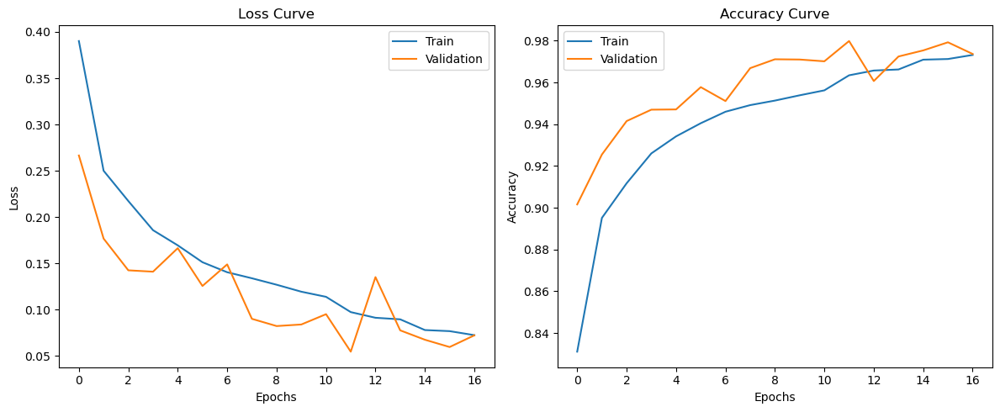

In [12]:
model.save('final_model.h5')
plot_learning_curves(history)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step


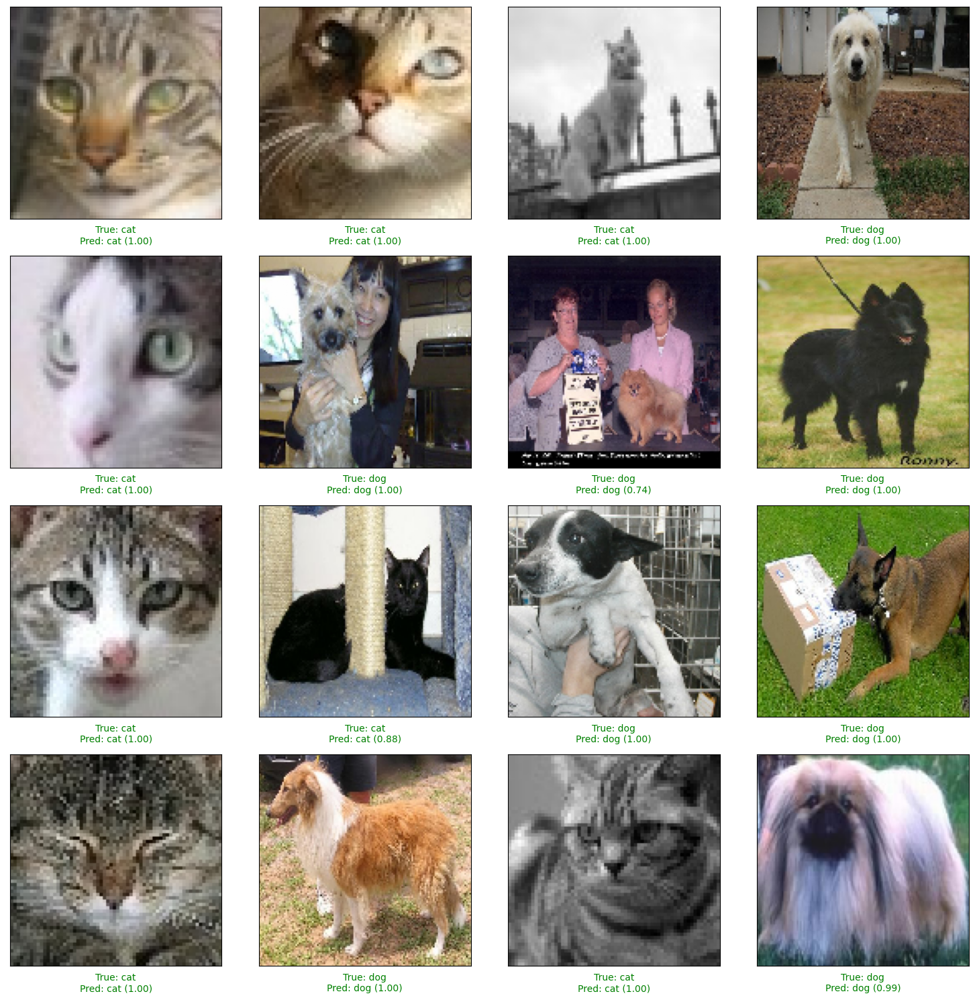

Accuracy on these samples: 100.00%
Cat accuracy: 100.00%
Dog accuracy: 100.00%
Generating confusion matrix...
Progress: 0/258 batches (0%)
Progress: 25/258 batches (9%)
Progress: 50/258 batches (19%)
Progress: 75/258 batches (29%)
Progress: 100/258 batches (38%)
Progress: 125/258 batches (48%)
Progress: 150/258 batches (58%)
Progress: 175/258 batches (67%)
Progress: 200/258 batches (77%)
Progress: 225/258 batches (87%)
Progress: 250/258 batches (96%)
Processing complete! Analyzed 8243 samples.


2025-05-06 13:14:45.856547: I tensorflow/core/framework/local_rendezvous.cc:407] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


<Figure size 800x800 with 0 Axes>

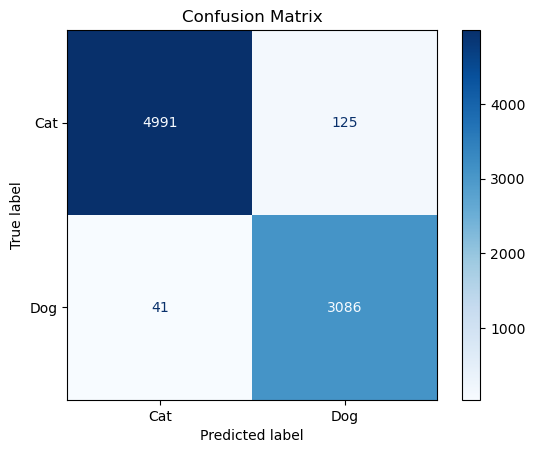

In [29]:
plot_balanced_sample_predictions(
    model=model,
    cat_folder='./preprocess/test/cat',
    dog_folder='./preprocess/test/dog',
    n_per_class=8  # Will show 8 cats and 8 dogs
)
generate_confusion_matrix(val_dataset, model, class_names, val_samples)



Analyzing image with true label: Cat


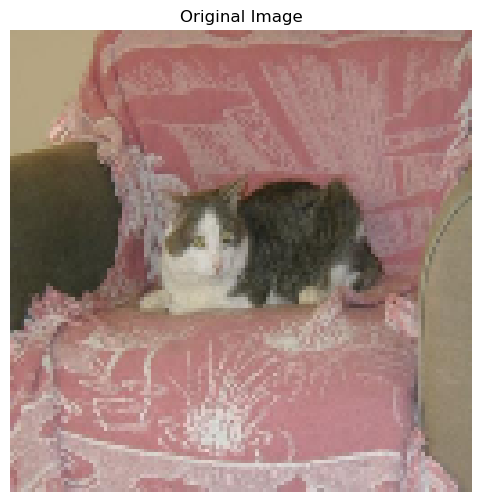

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


/home/chadifares/.local/lib/python3.12/site-packages/keras/src/models/functional.py:238: UserWarning: The structure of `inputs` doesn't match the expected structure.
Expected: ['keras_tensor']
Received: inputs=Tensor(shape=(1, 128, 128, 3))
  warnings.warn(msg)


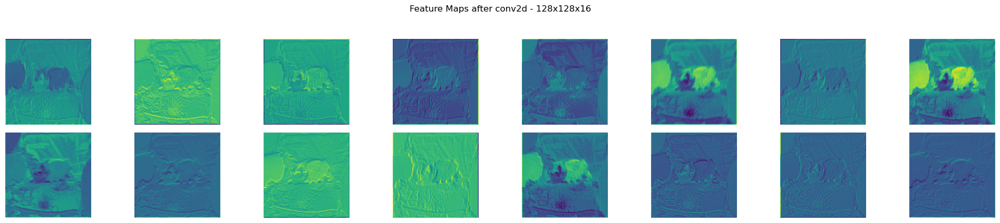

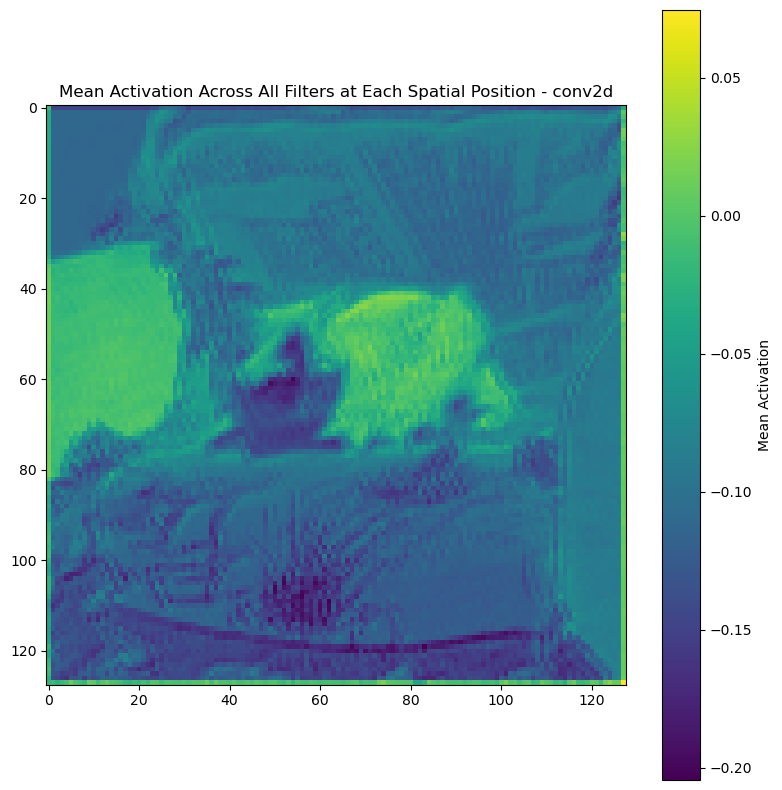

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 290ms/step


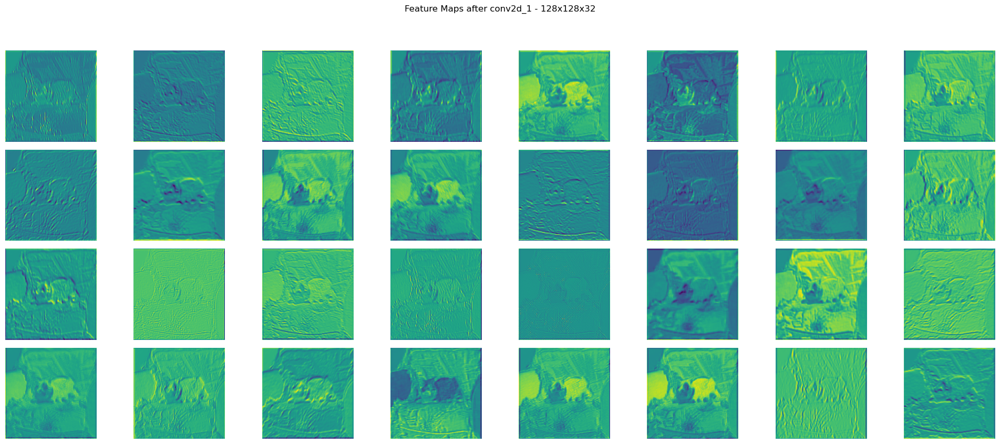

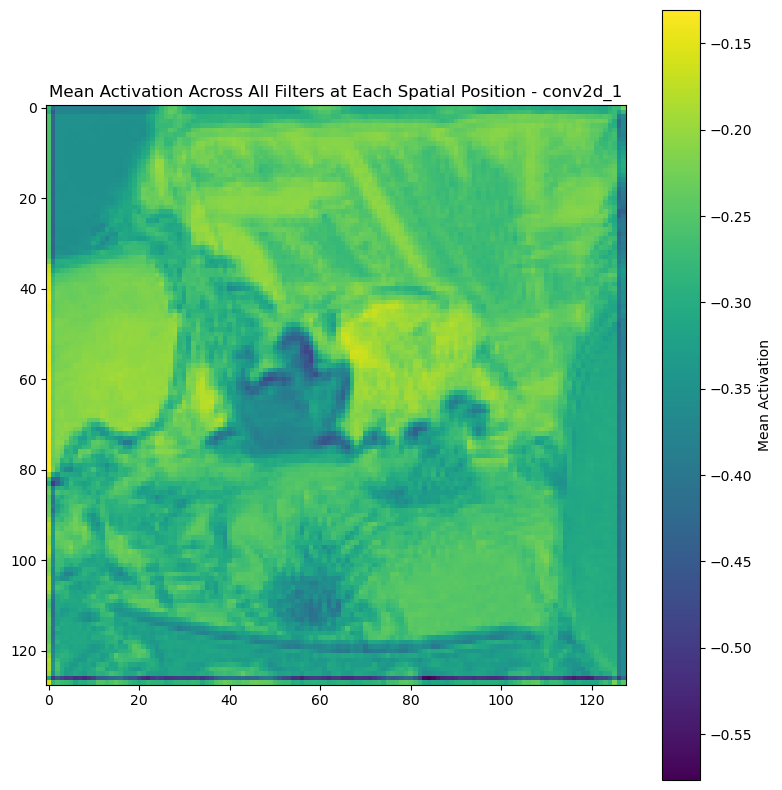

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


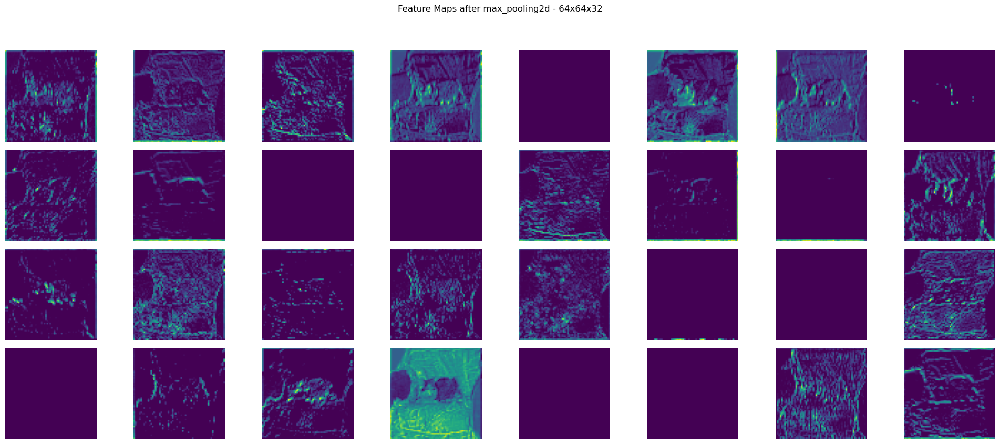

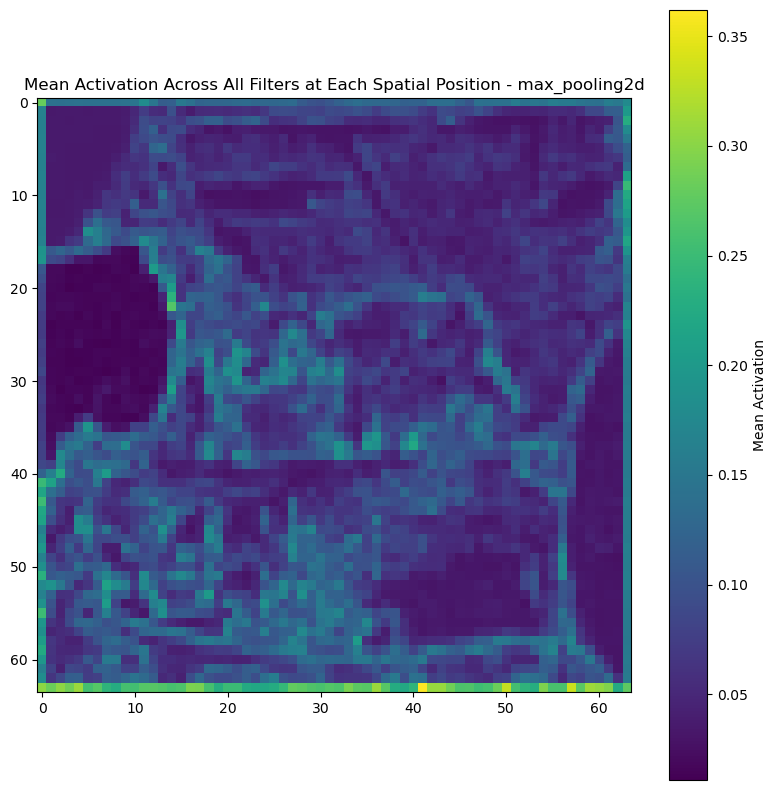

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


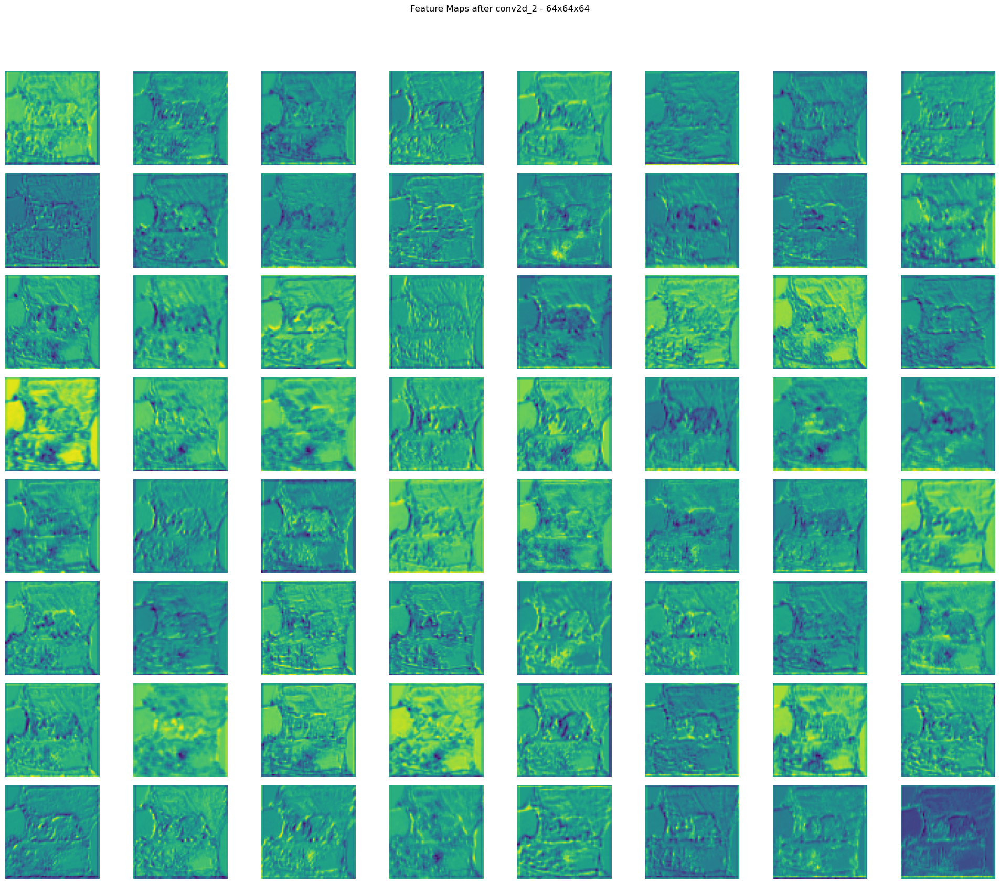

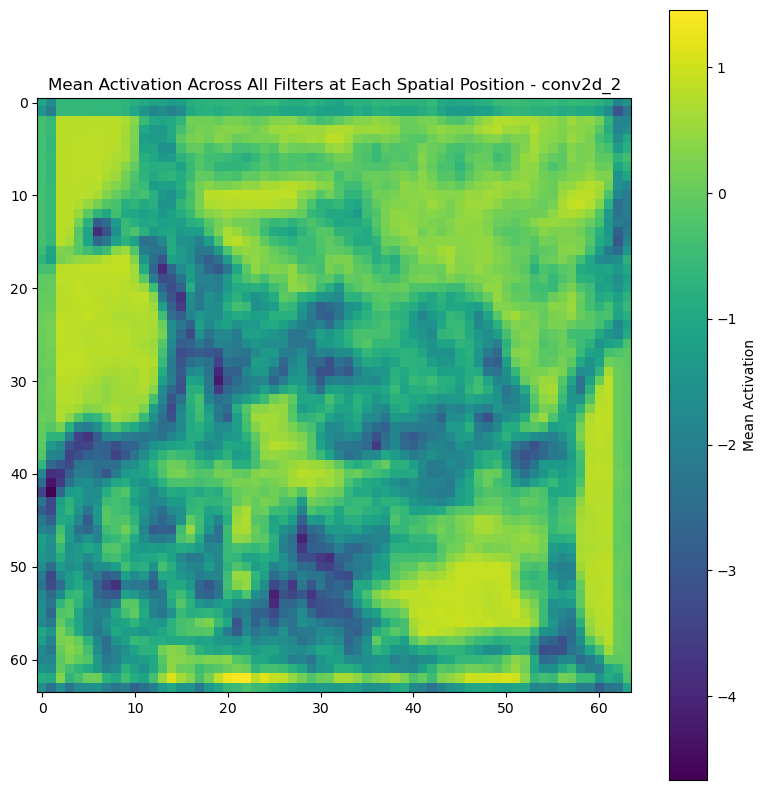

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 309ms/step


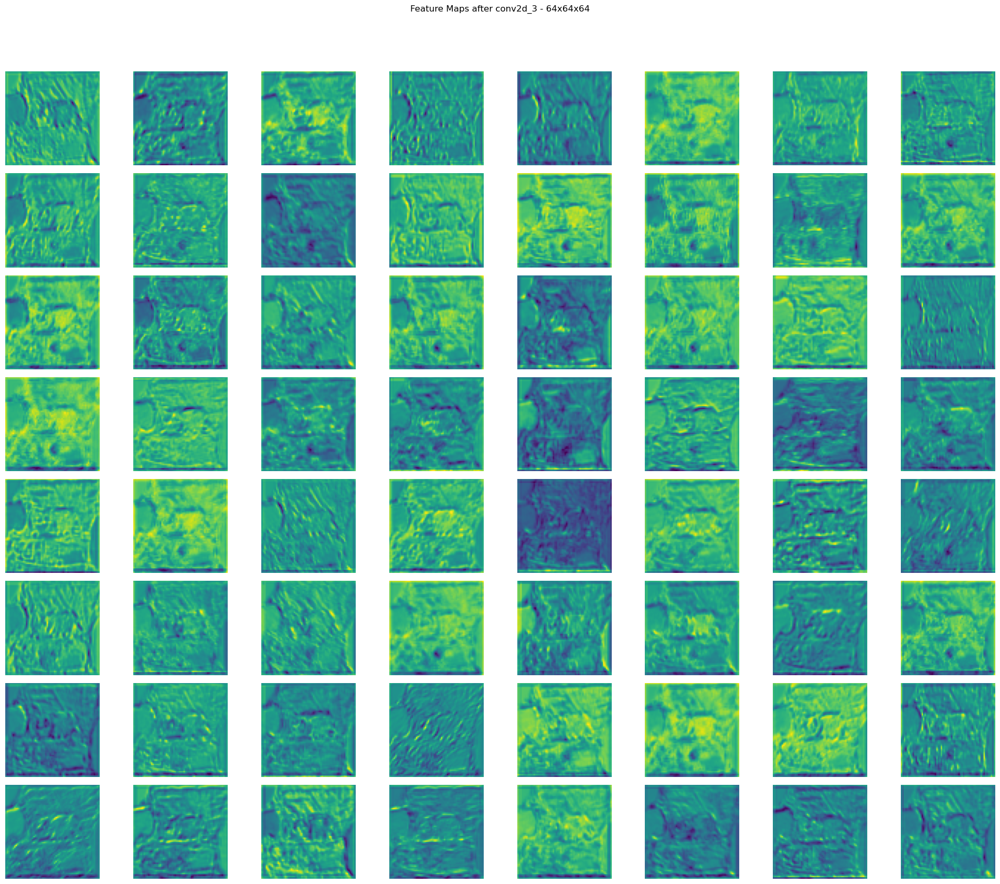

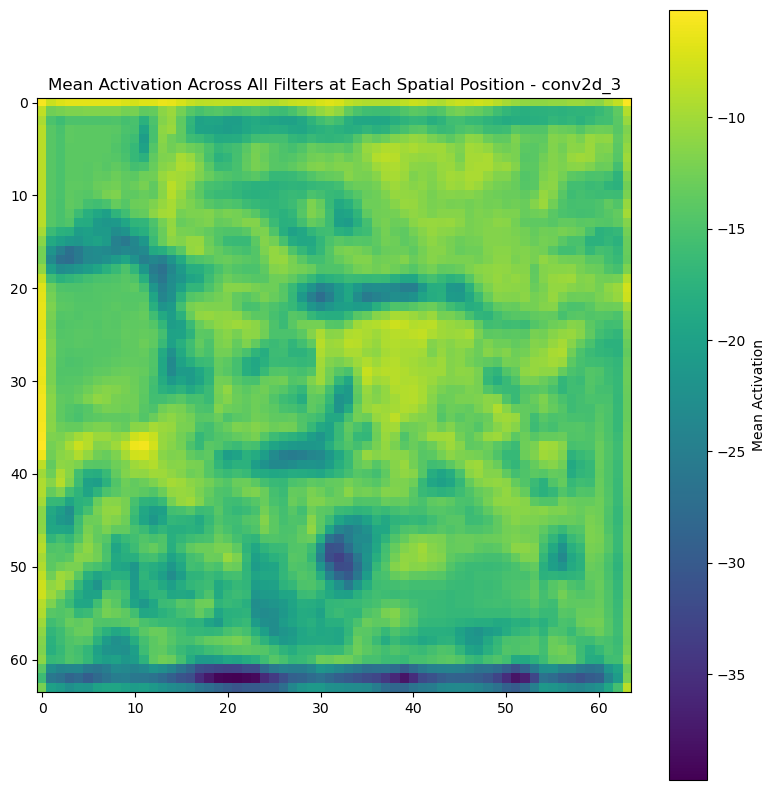

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


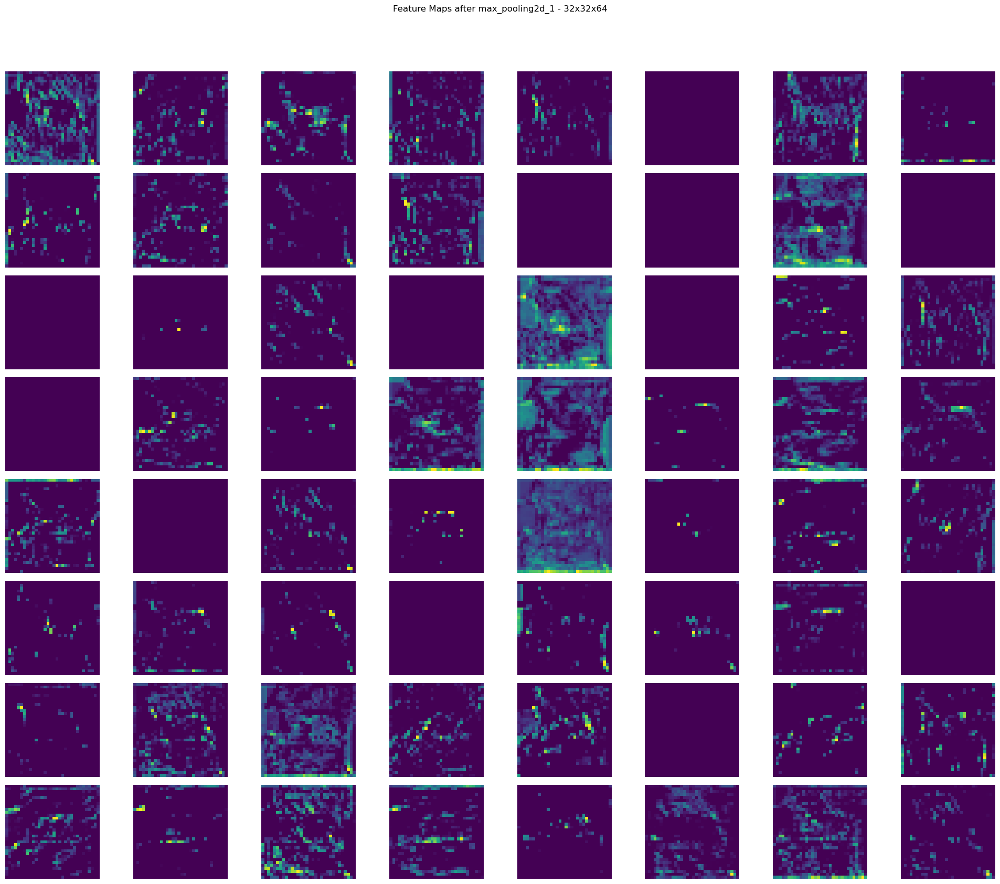

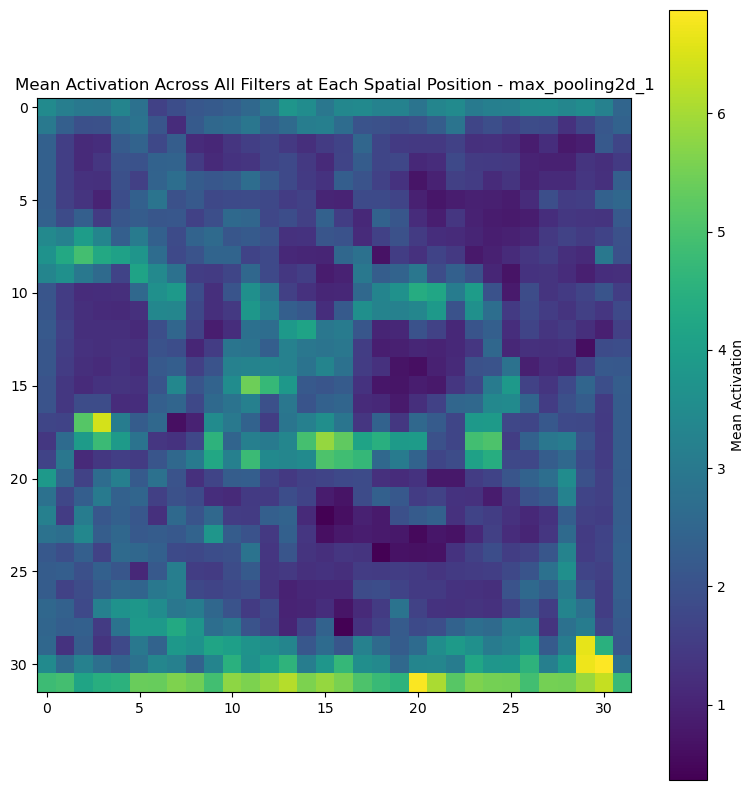

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


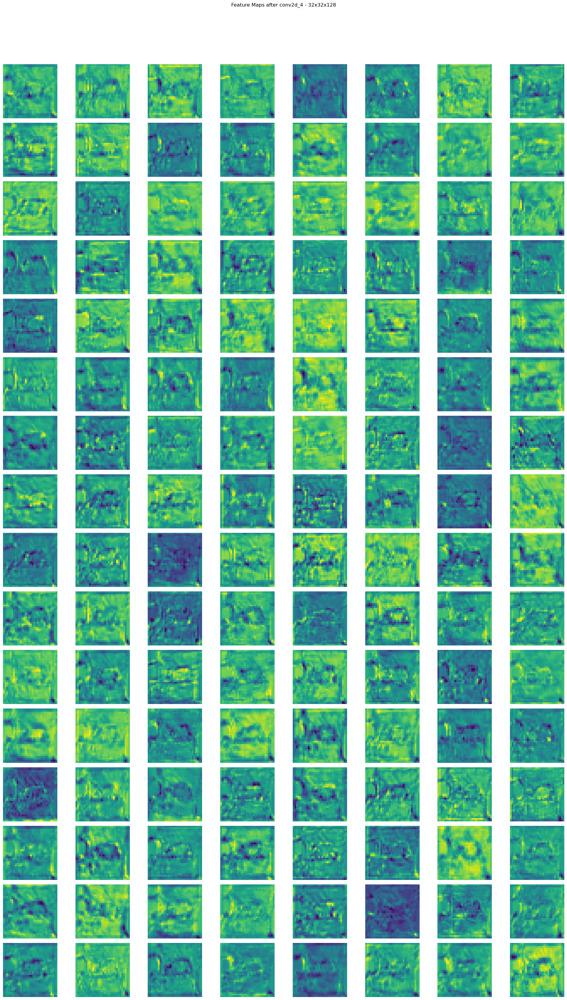

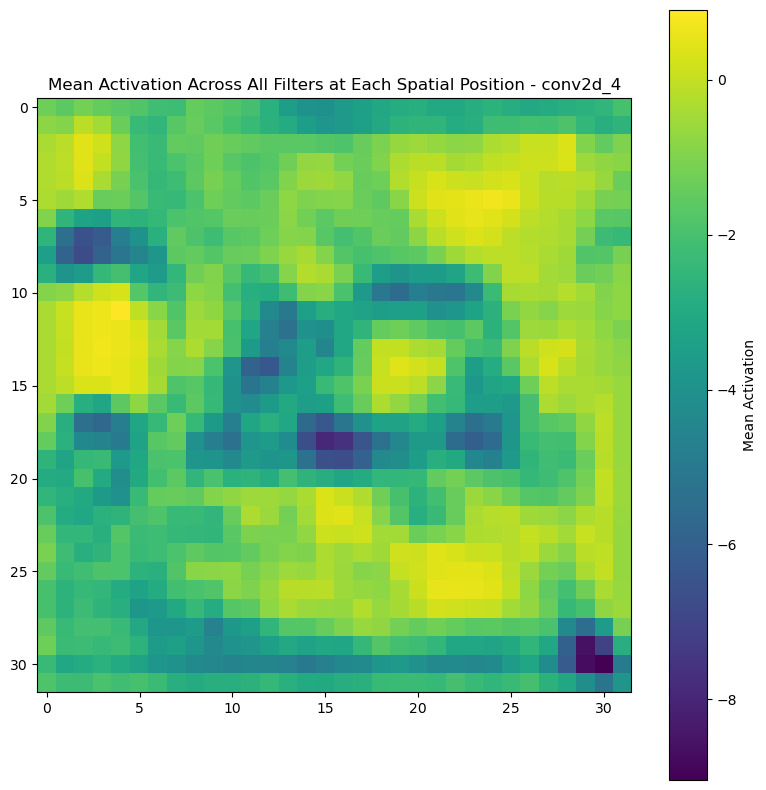

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


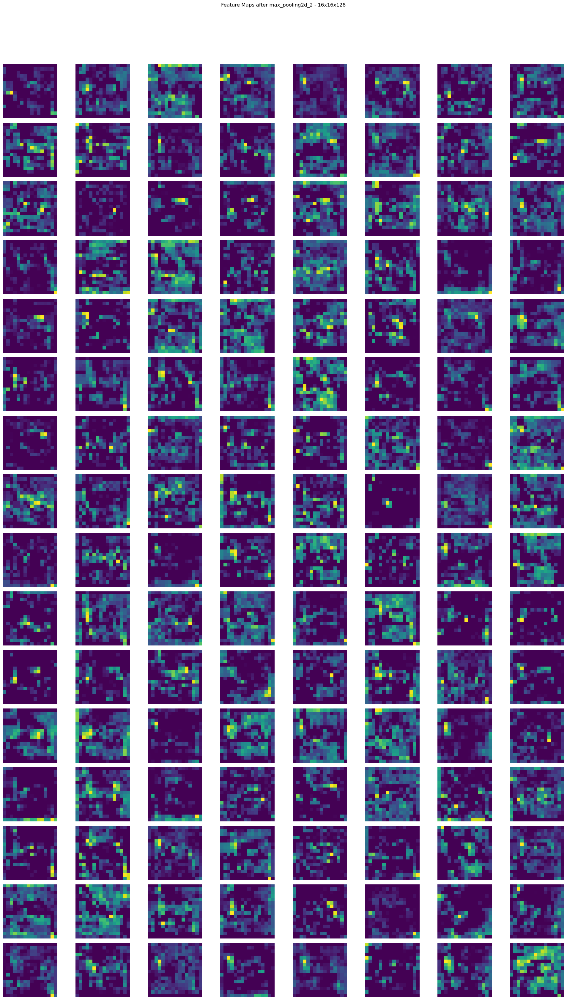

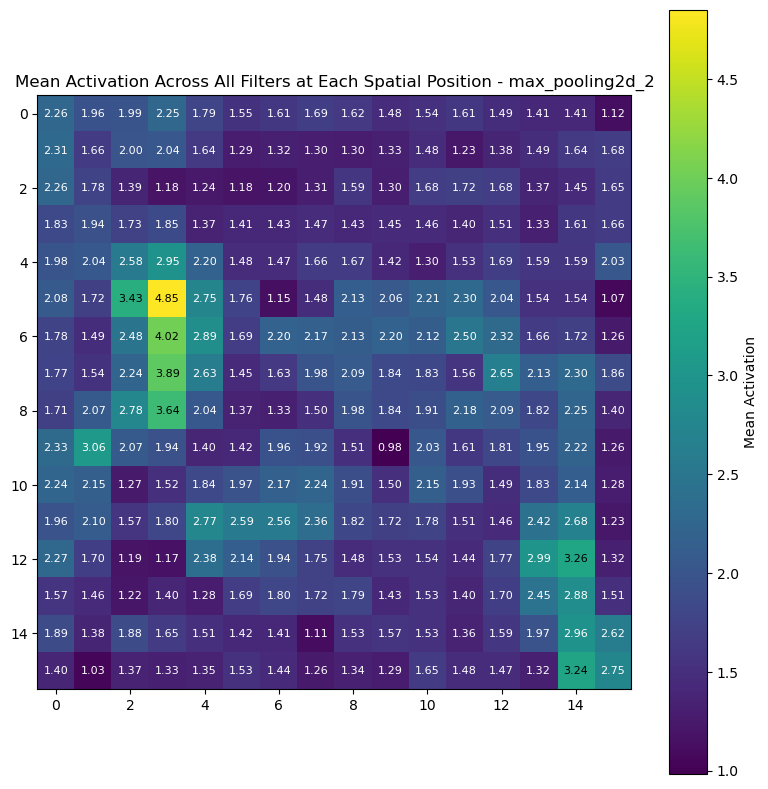

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 316ms/step


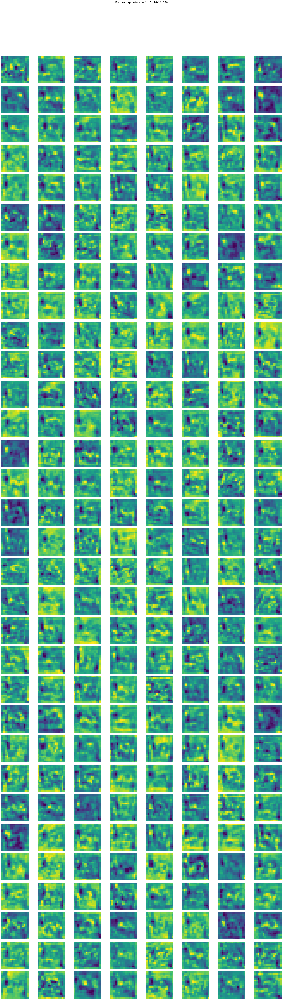

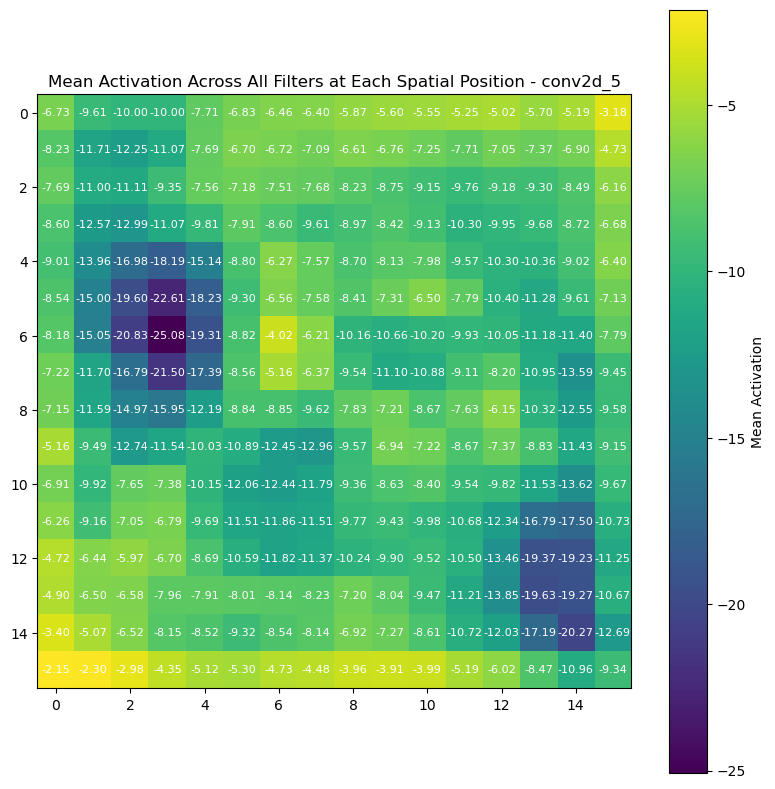

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 309ms/step


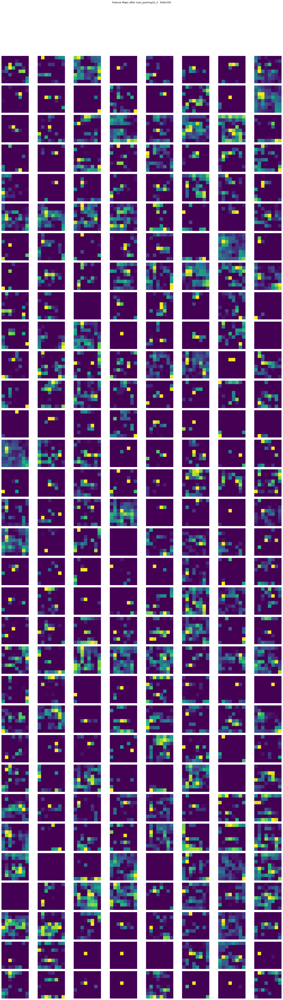

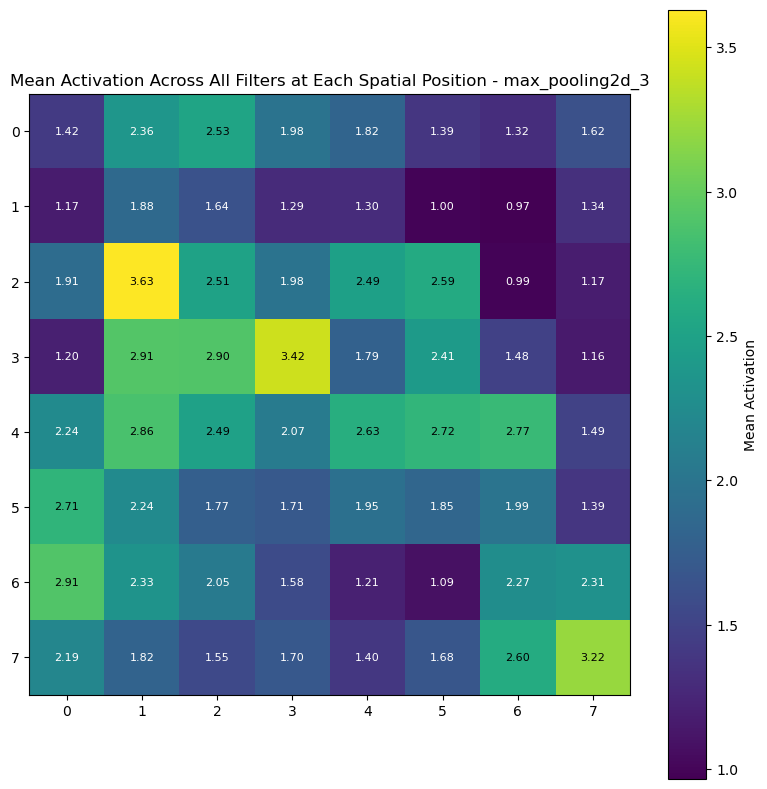

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 365ms/step


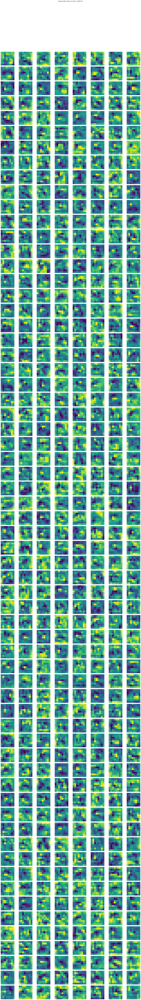

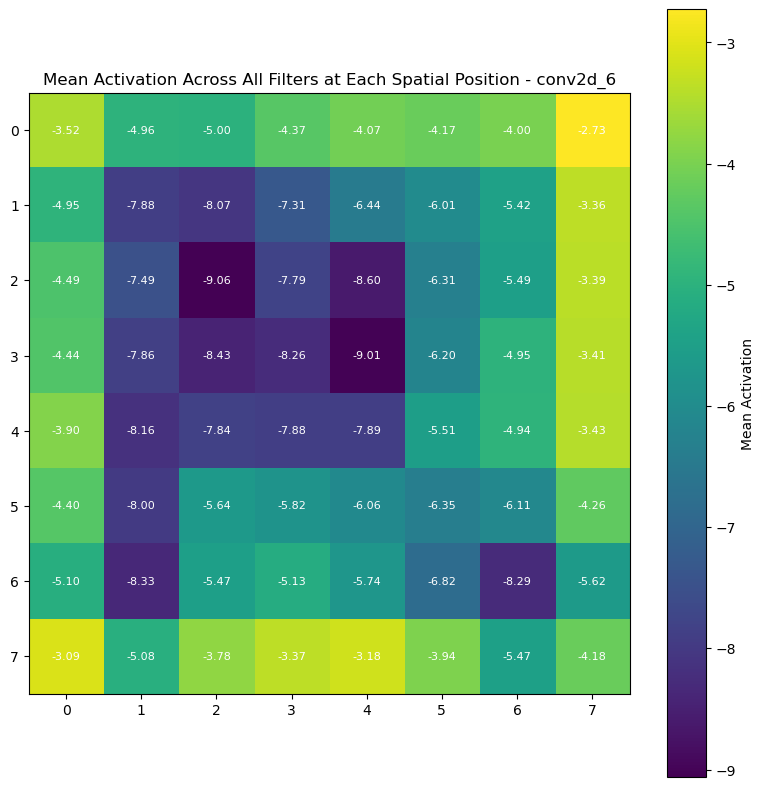

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 358ms/step


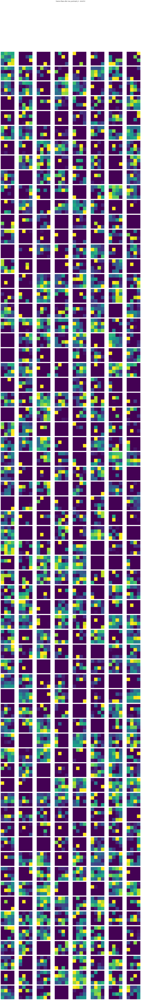

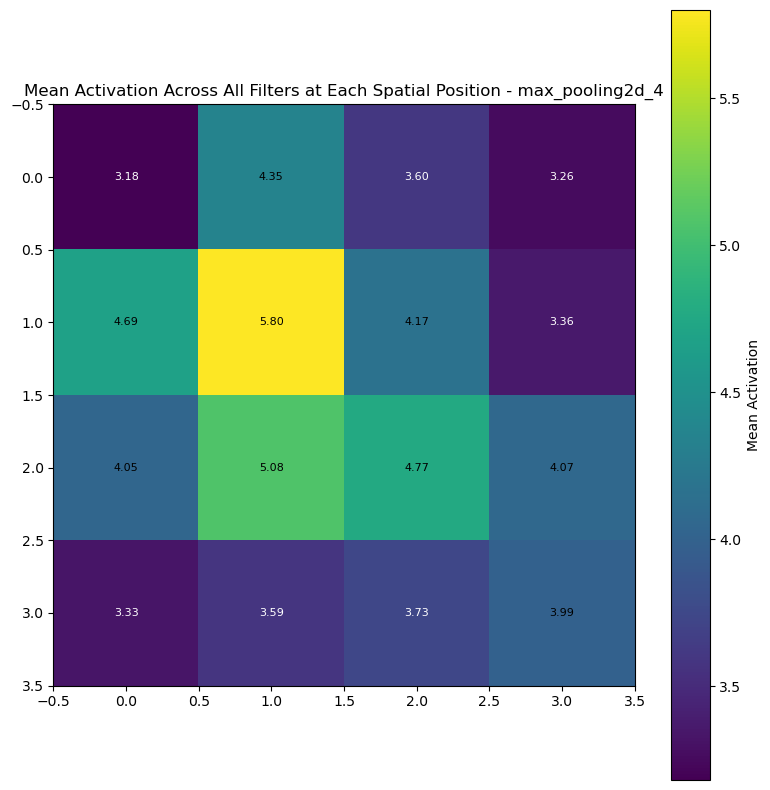



Analyzing image with true label: Cat


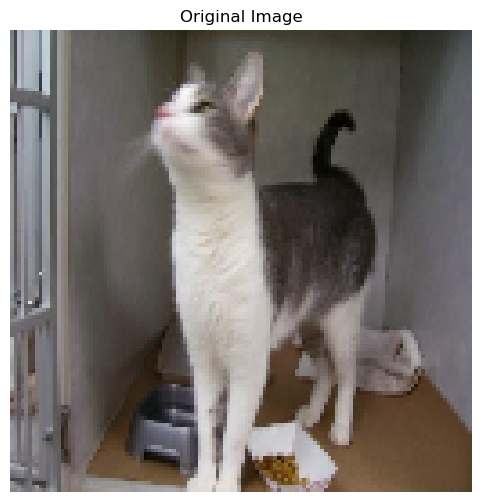

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


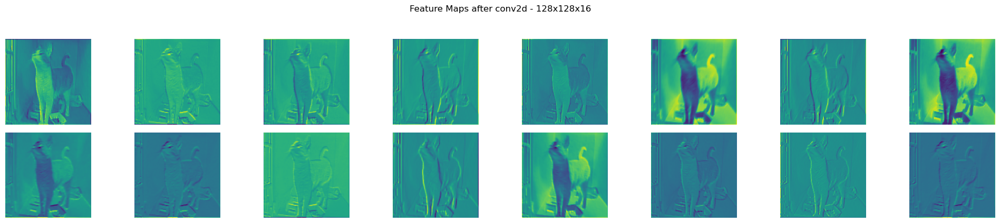

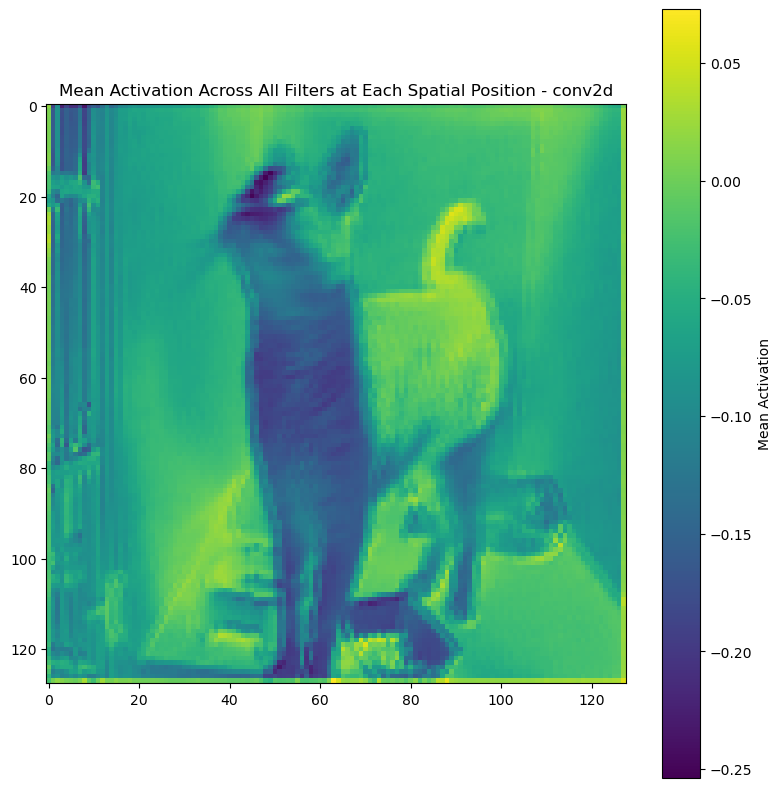

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


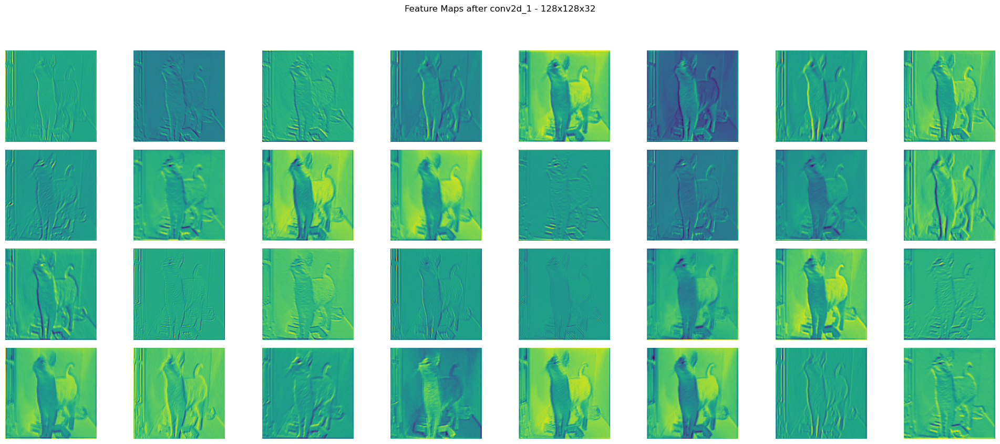

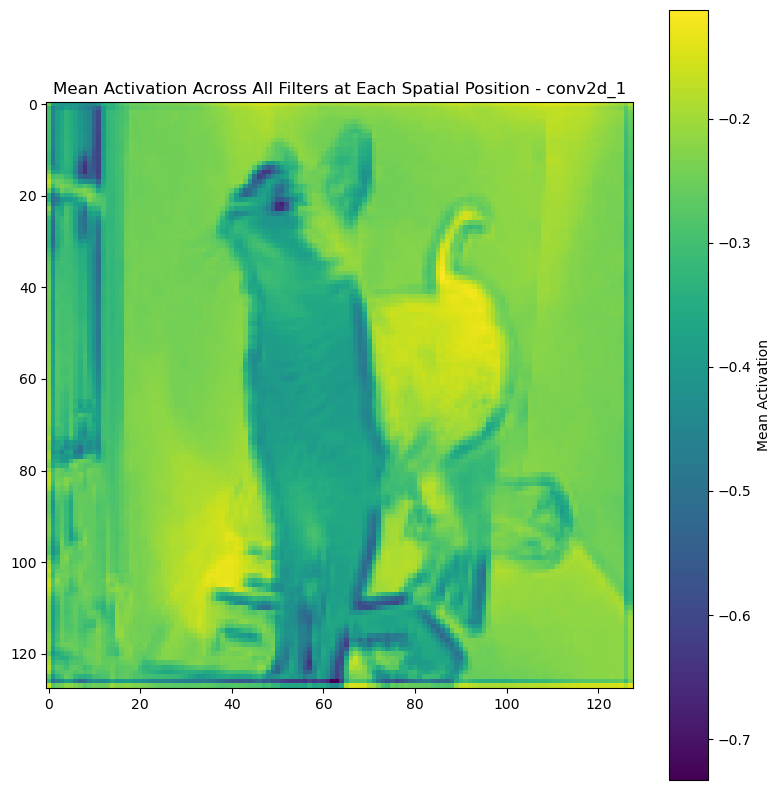

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


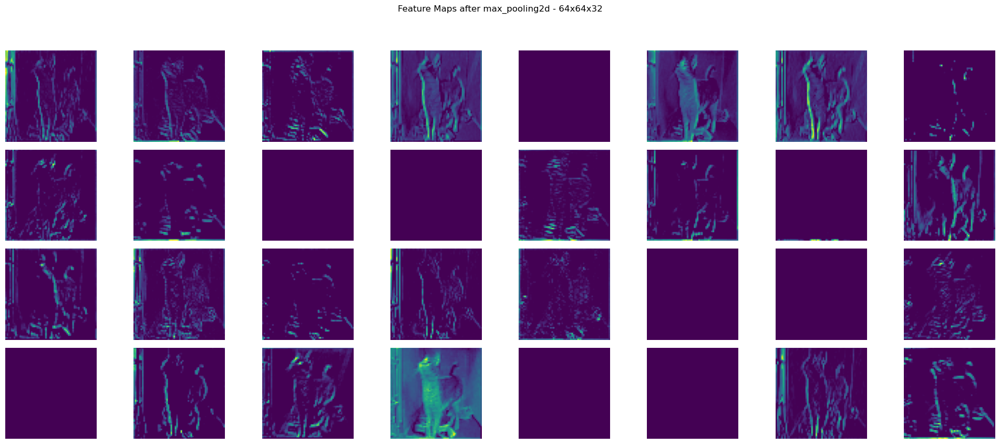

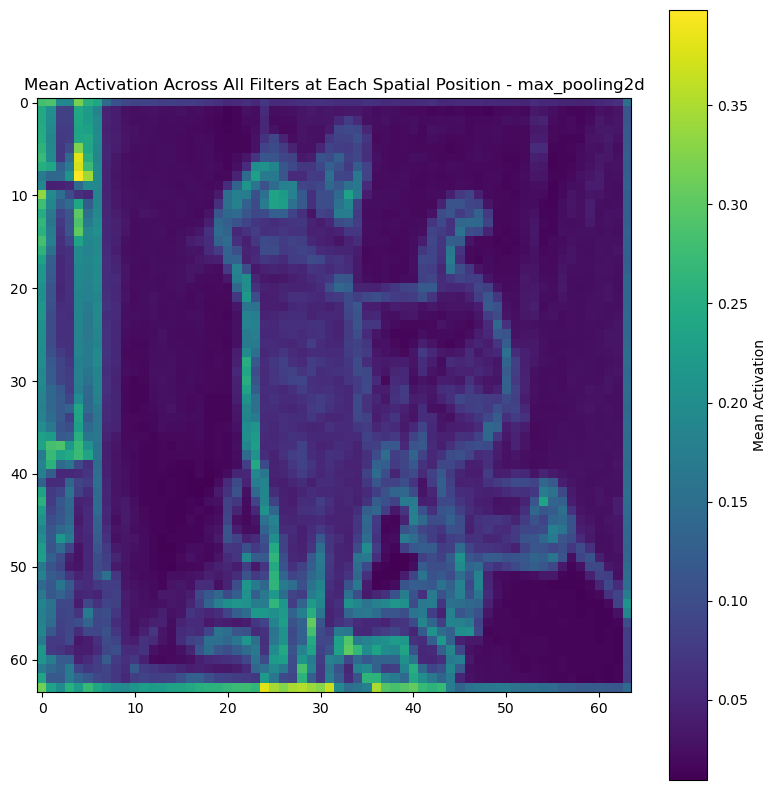

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


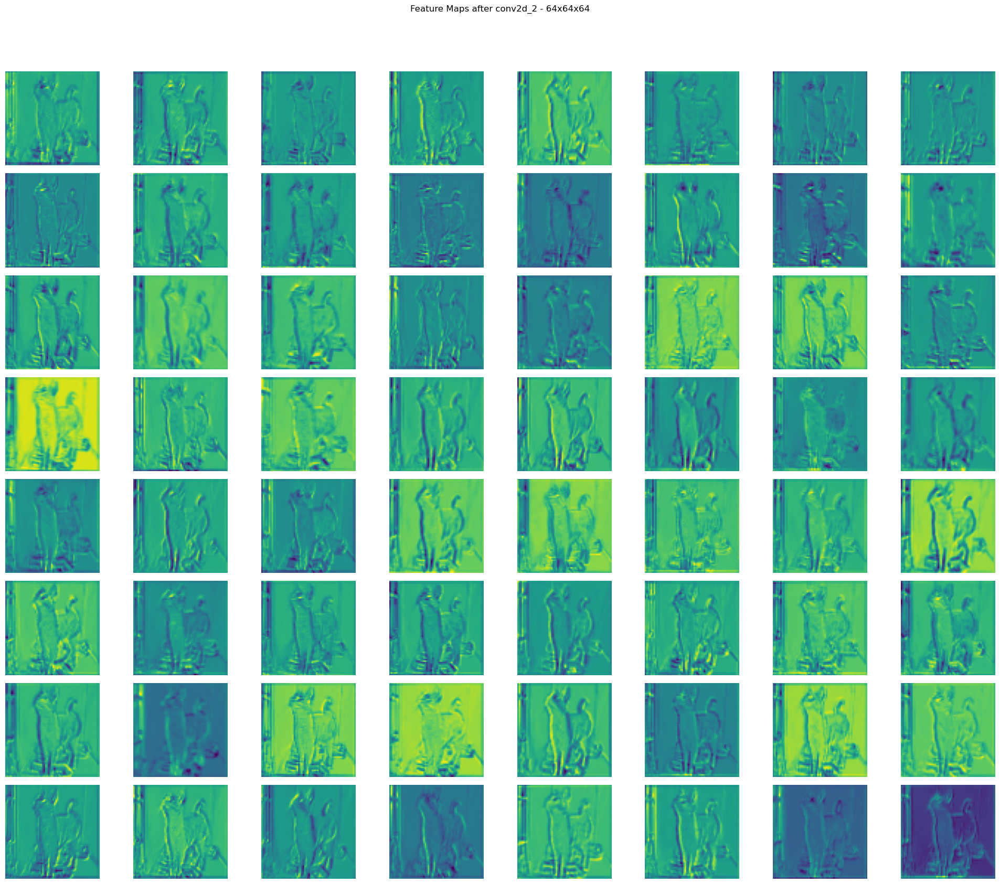

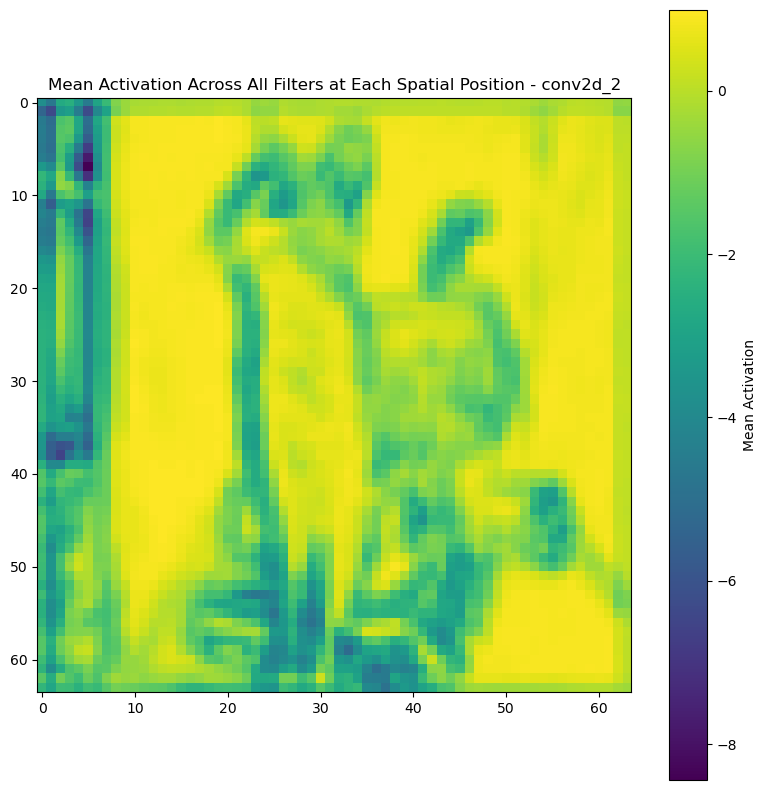

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


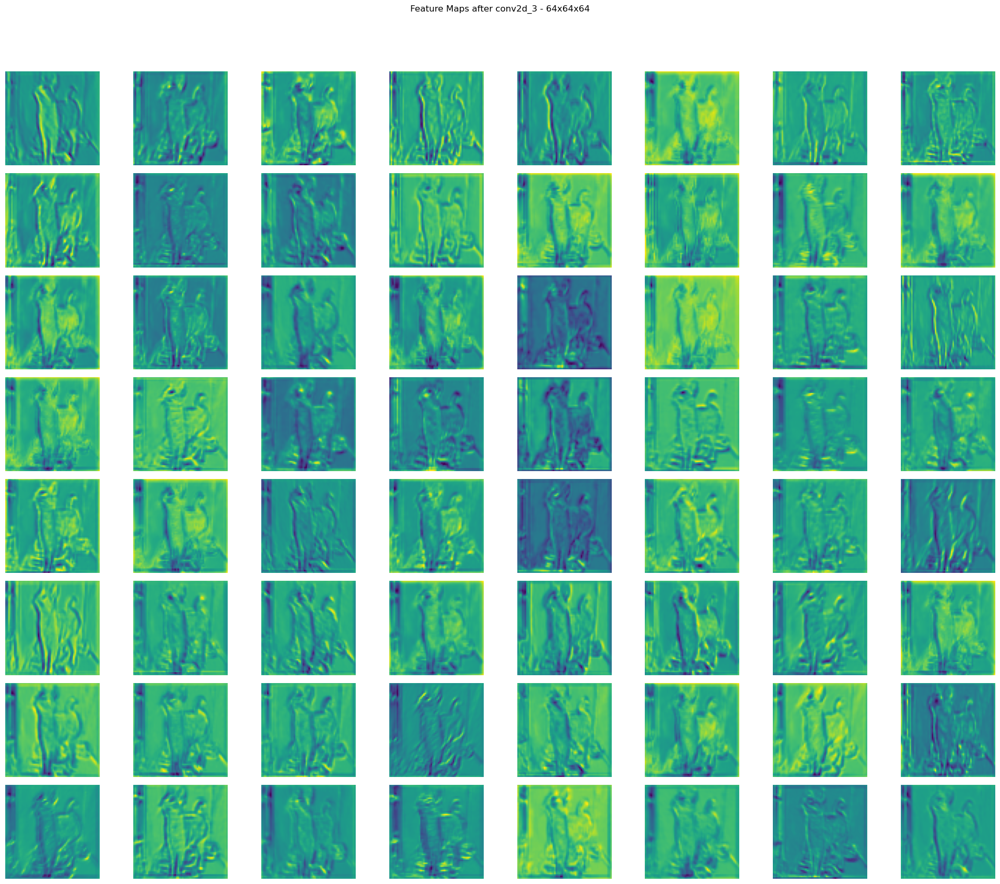

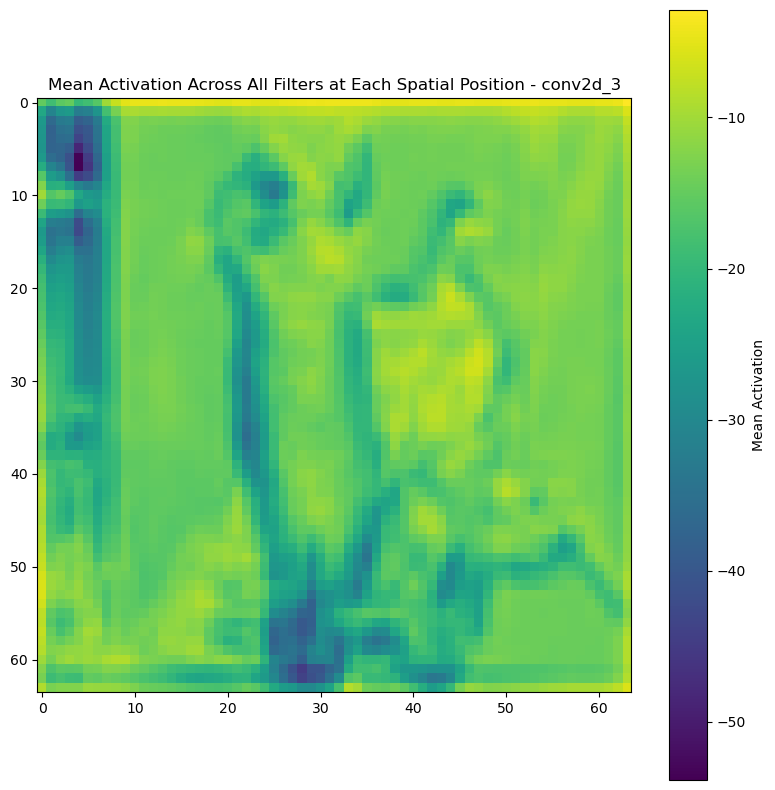

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


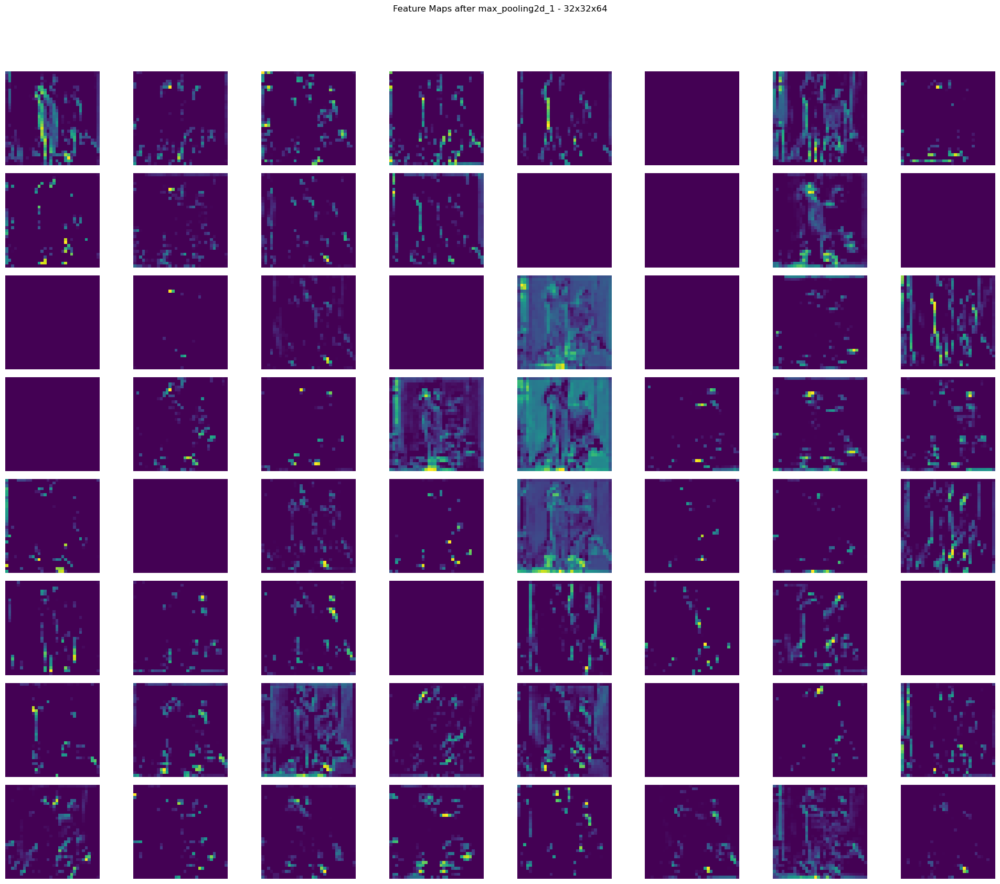

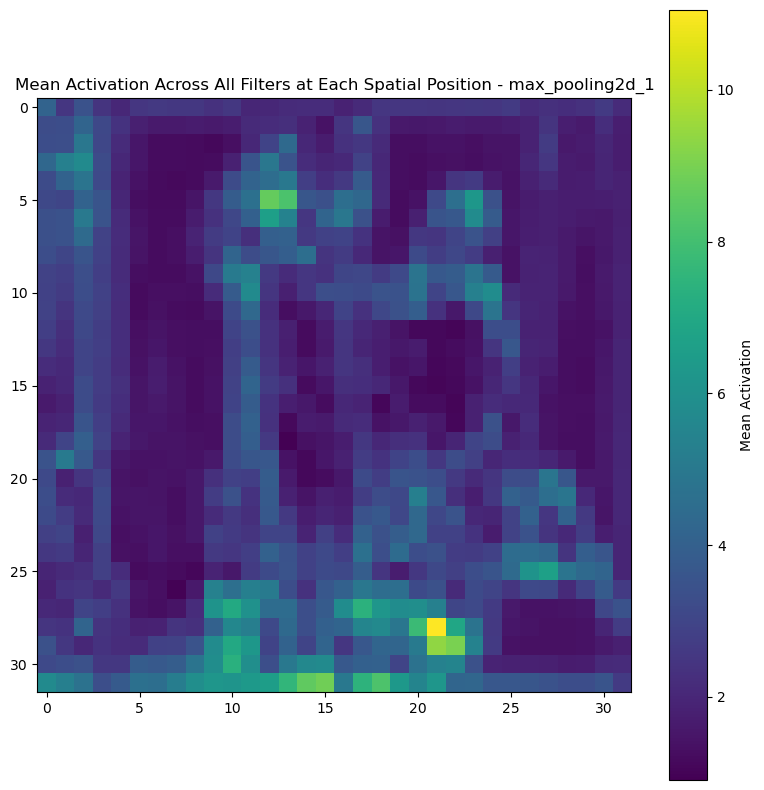

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


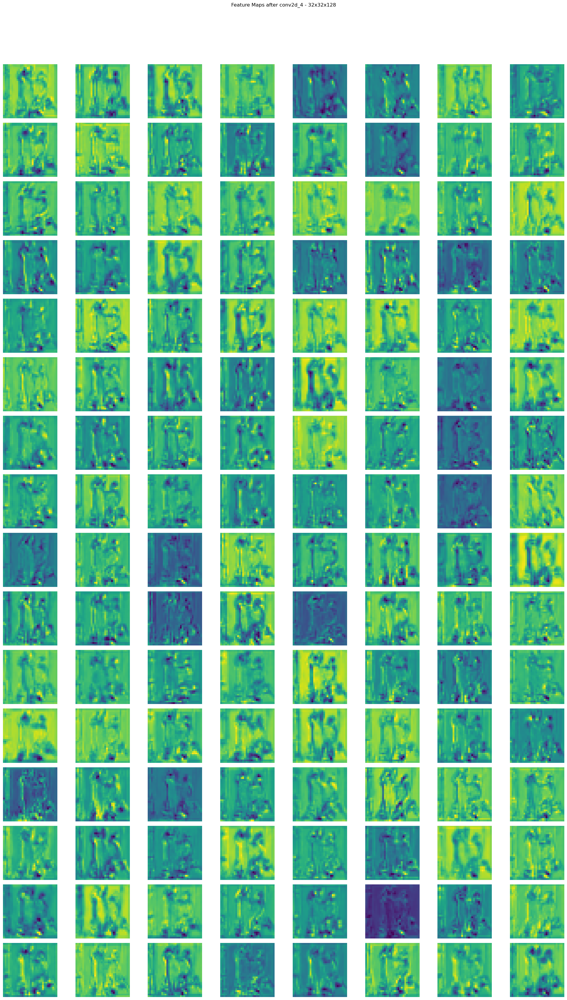

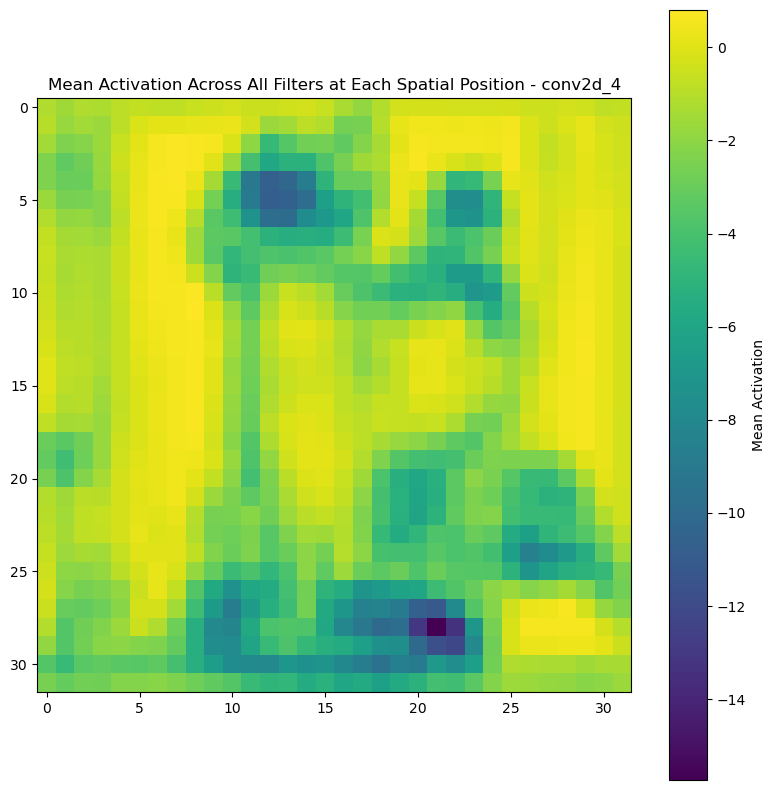

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


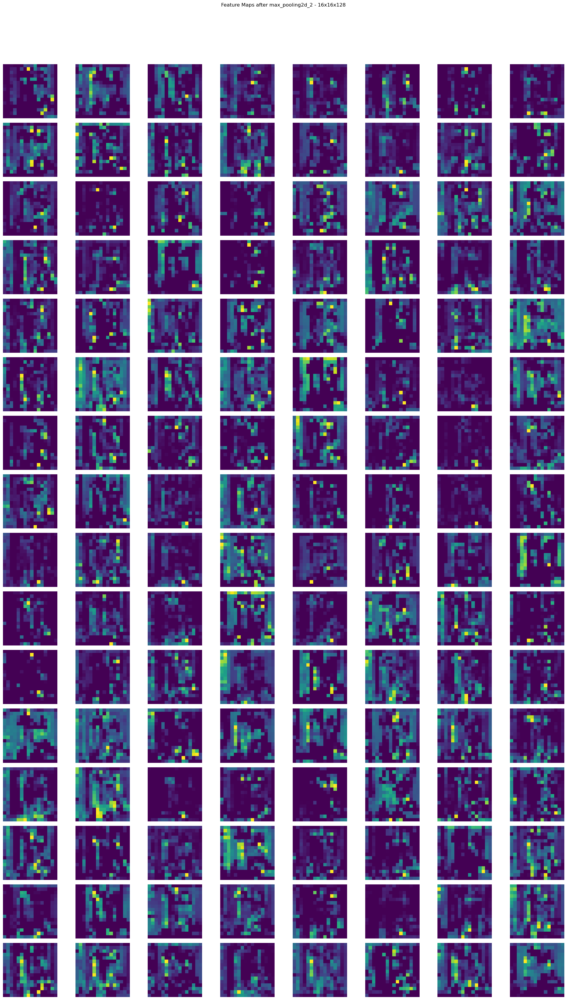

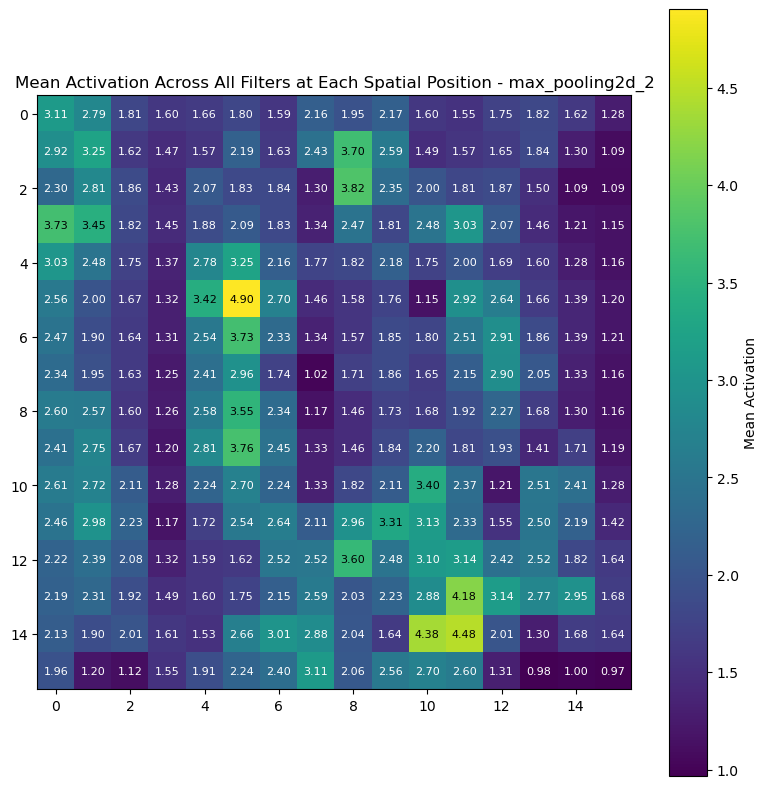

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


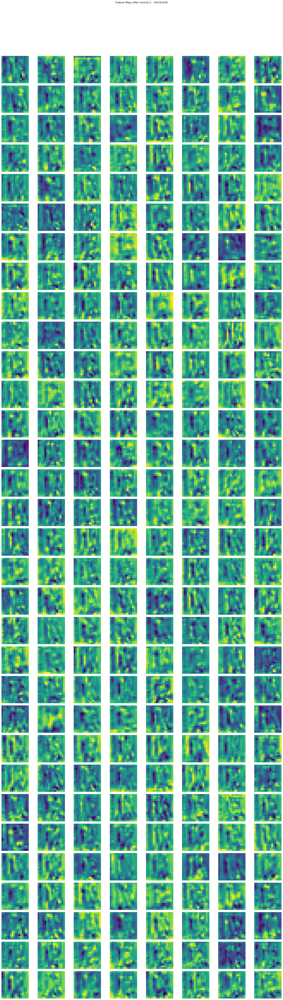

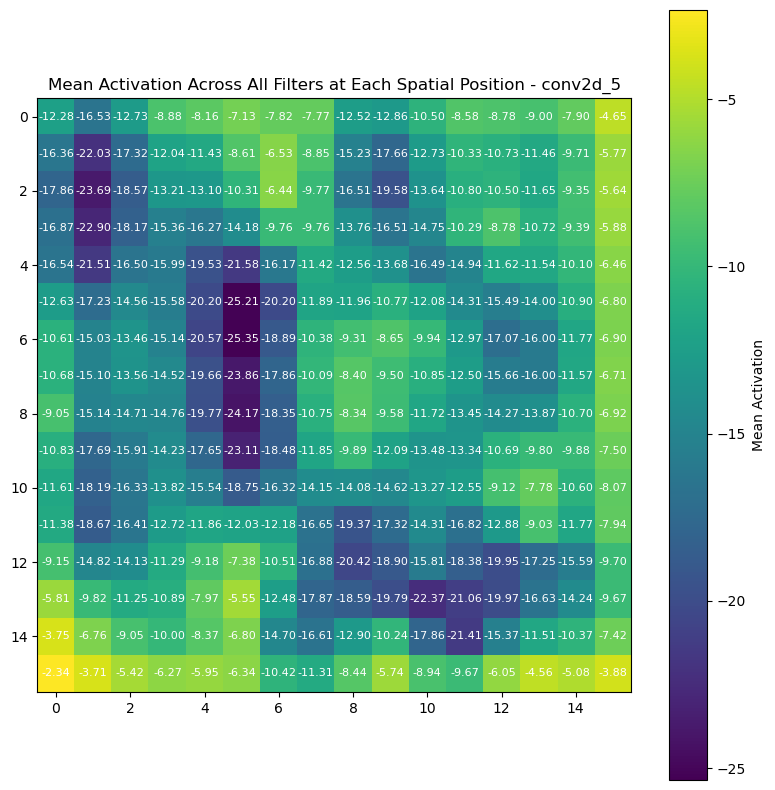

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


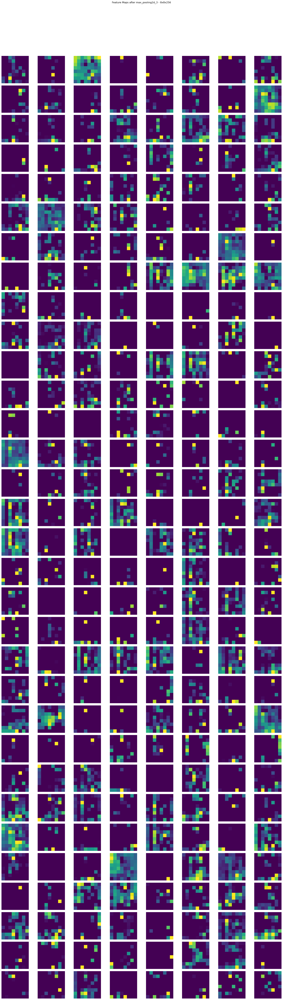

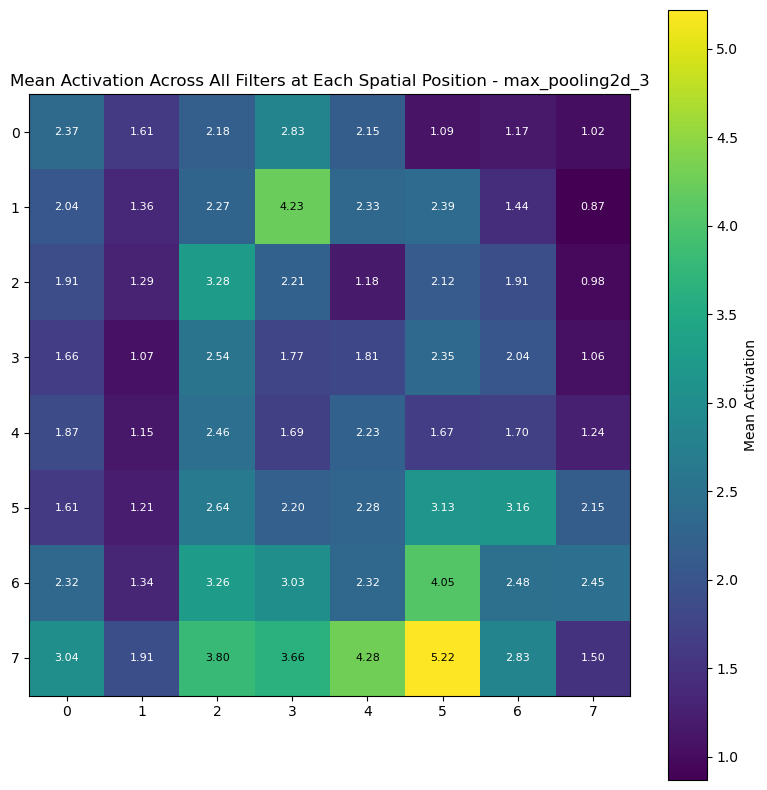

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


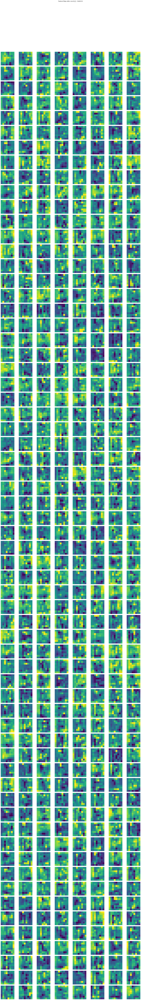

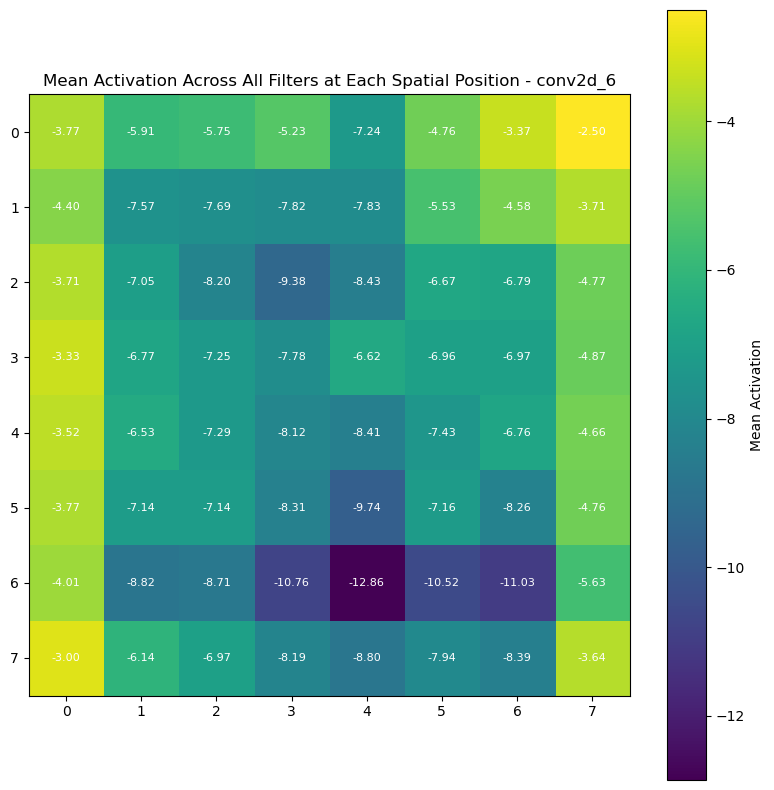

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


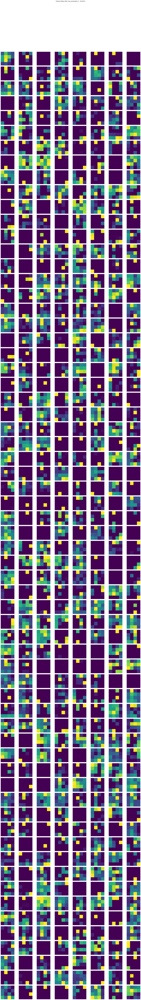

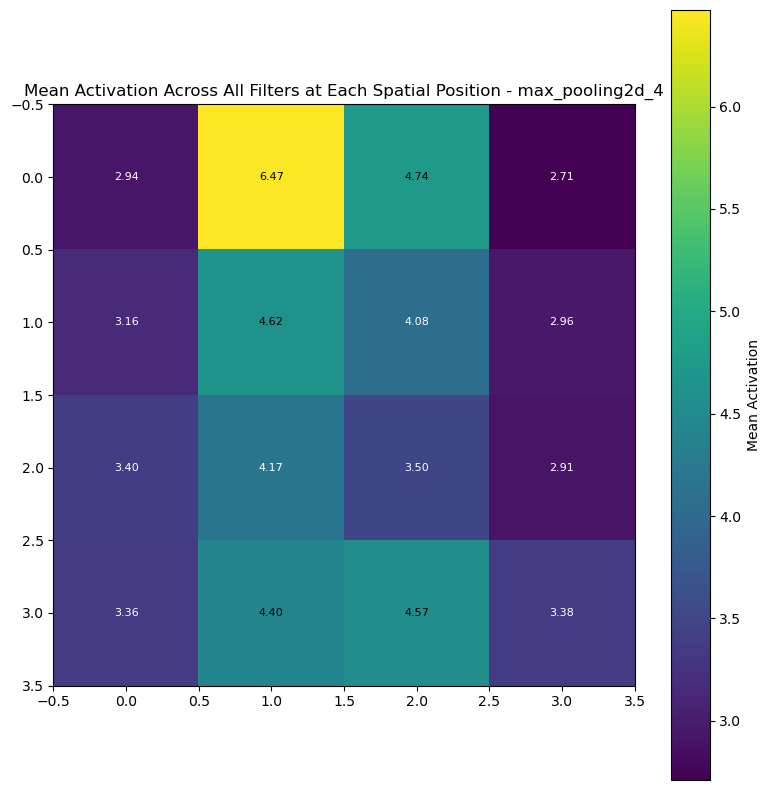



Analyzing image with true label: Cat


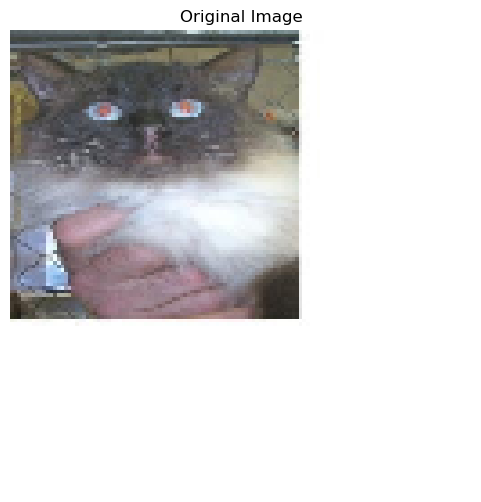

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


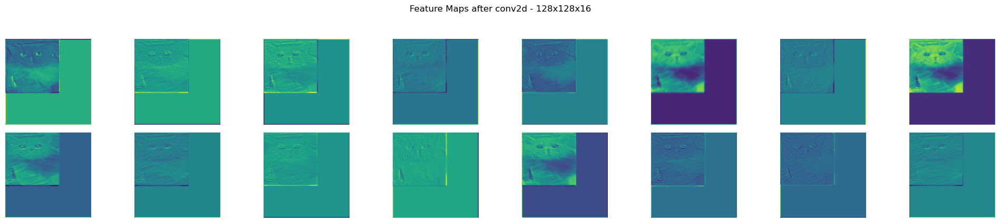

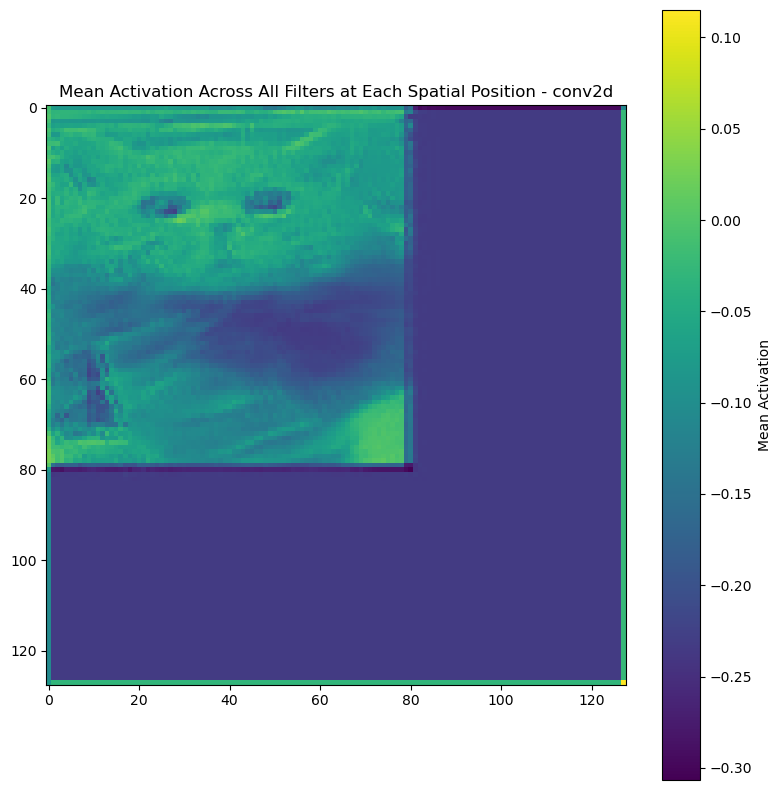

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


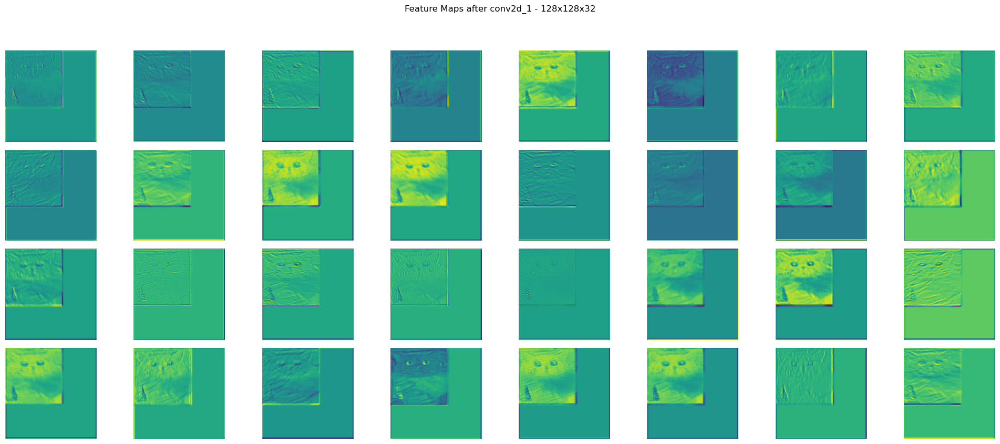

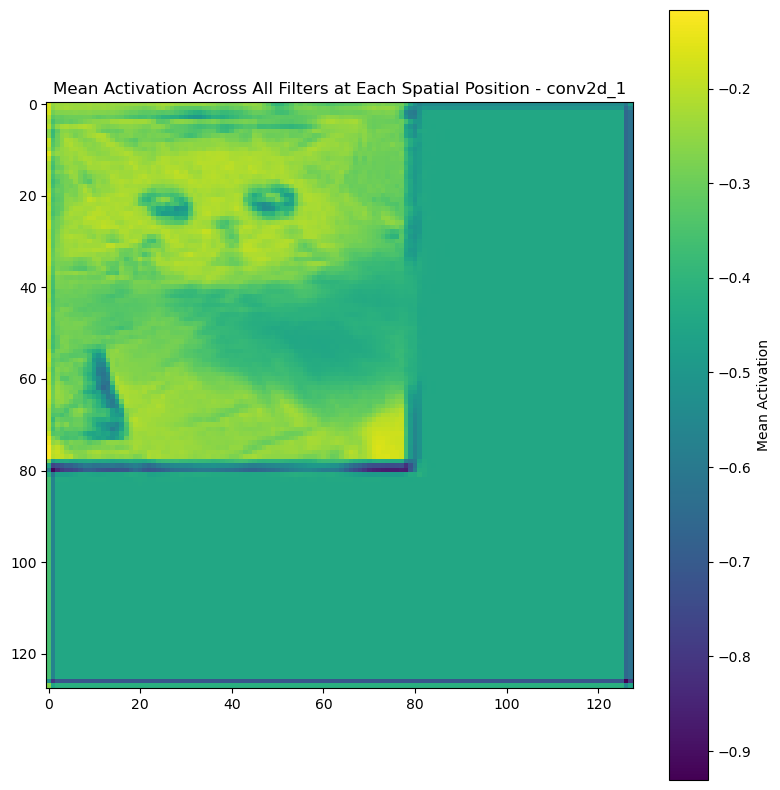

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


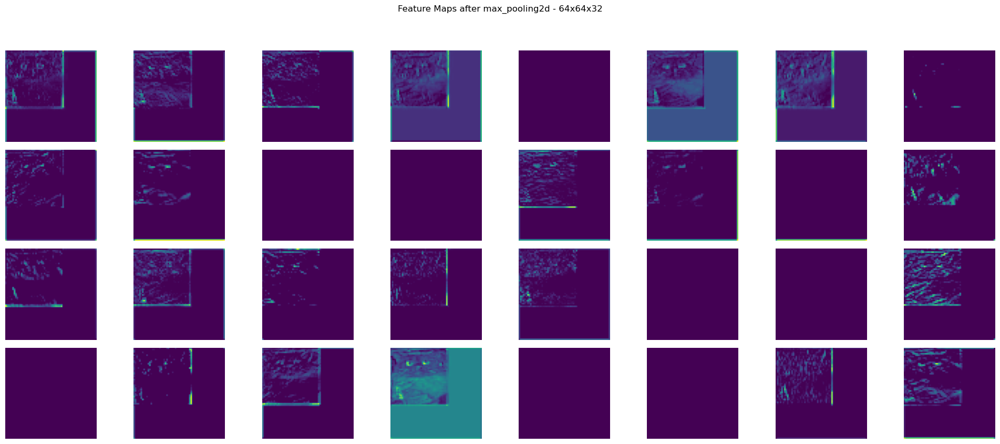

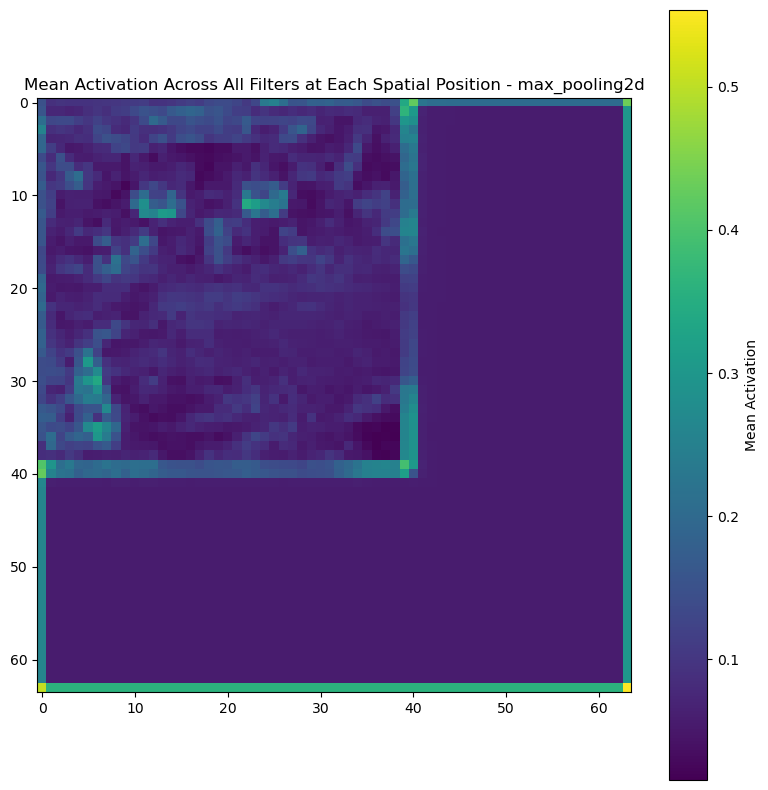

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


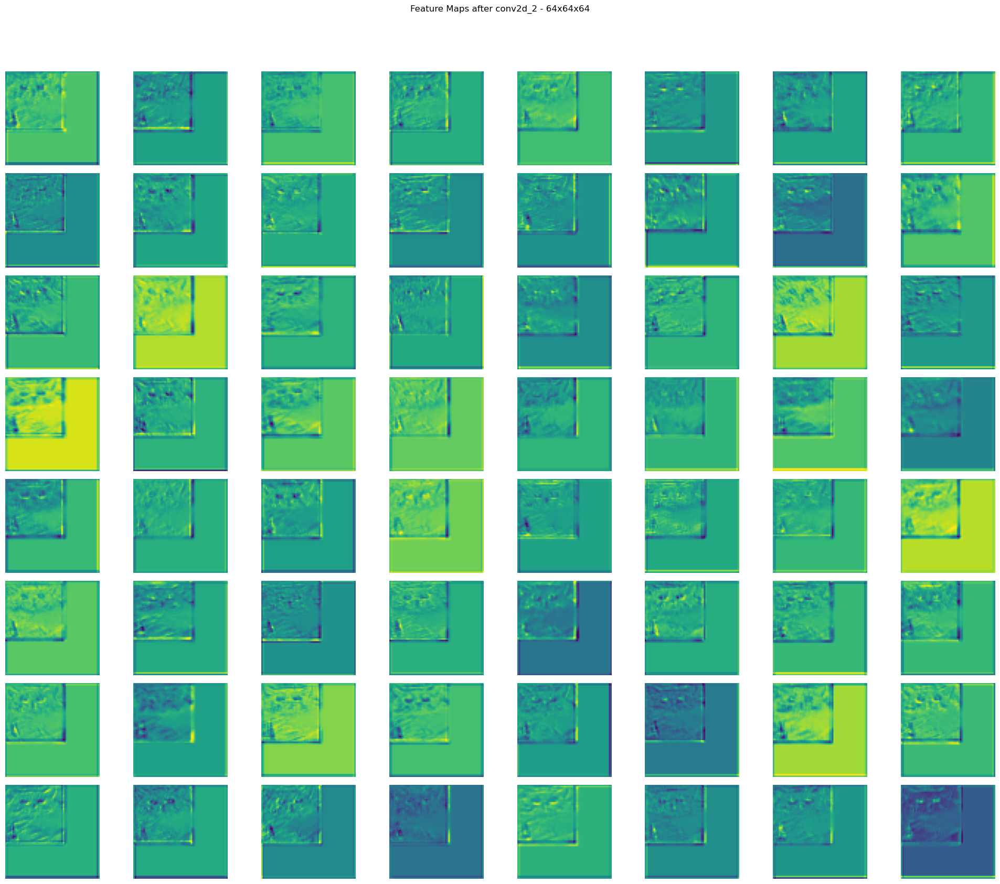

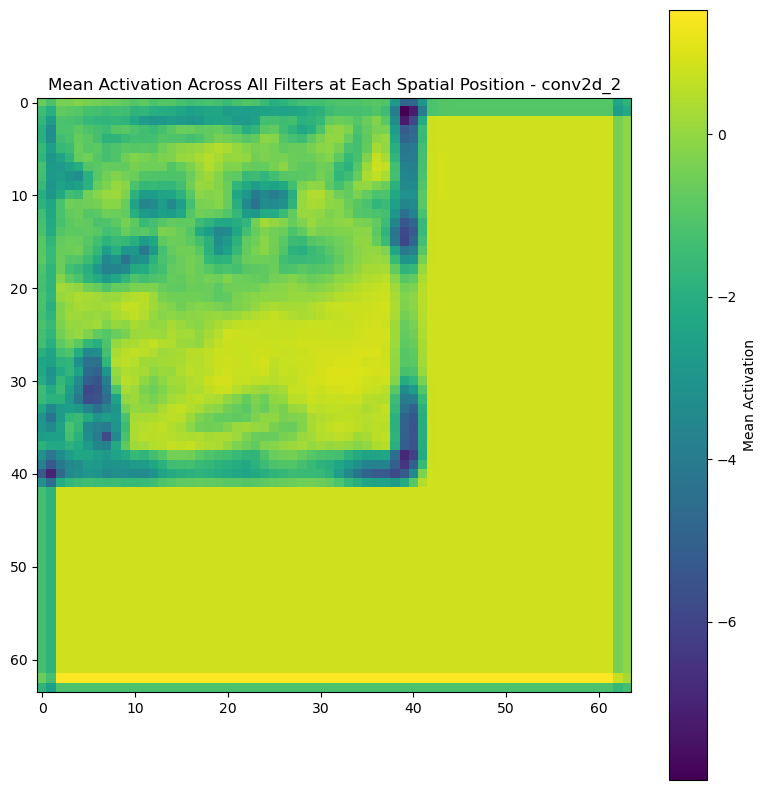

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


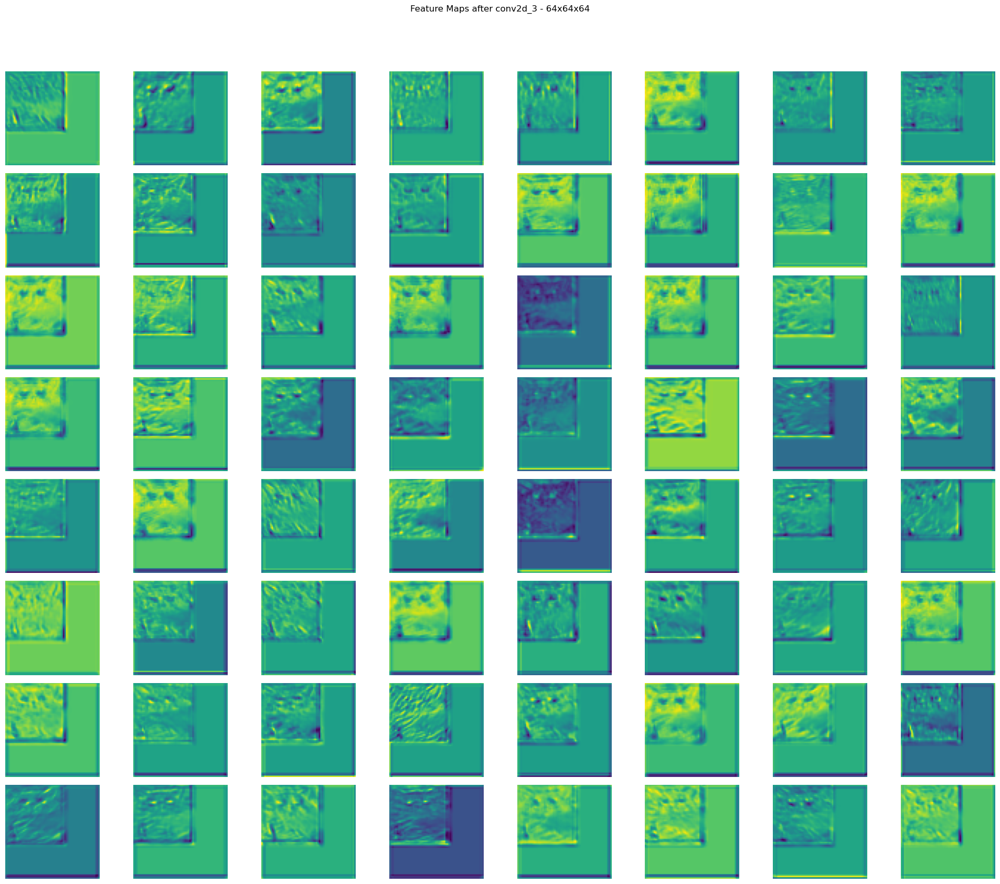

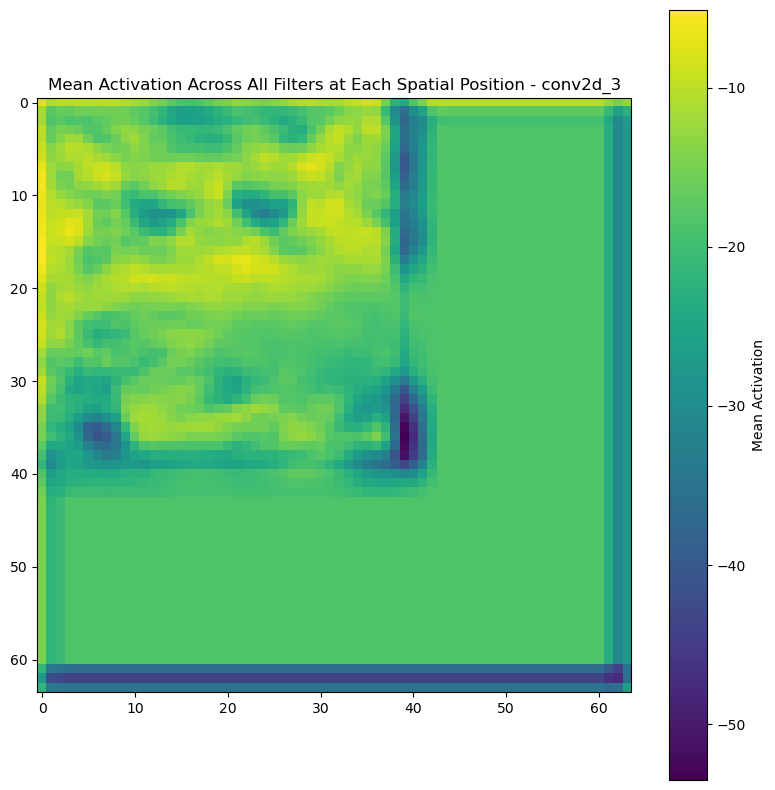

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


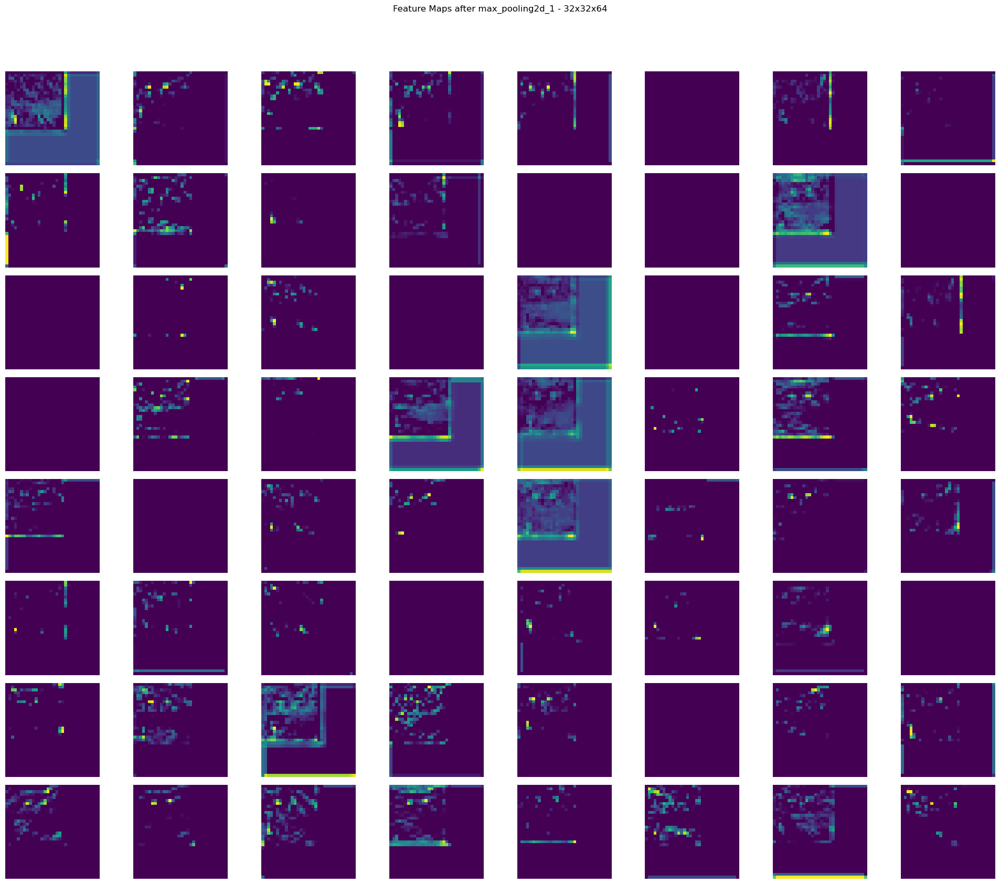

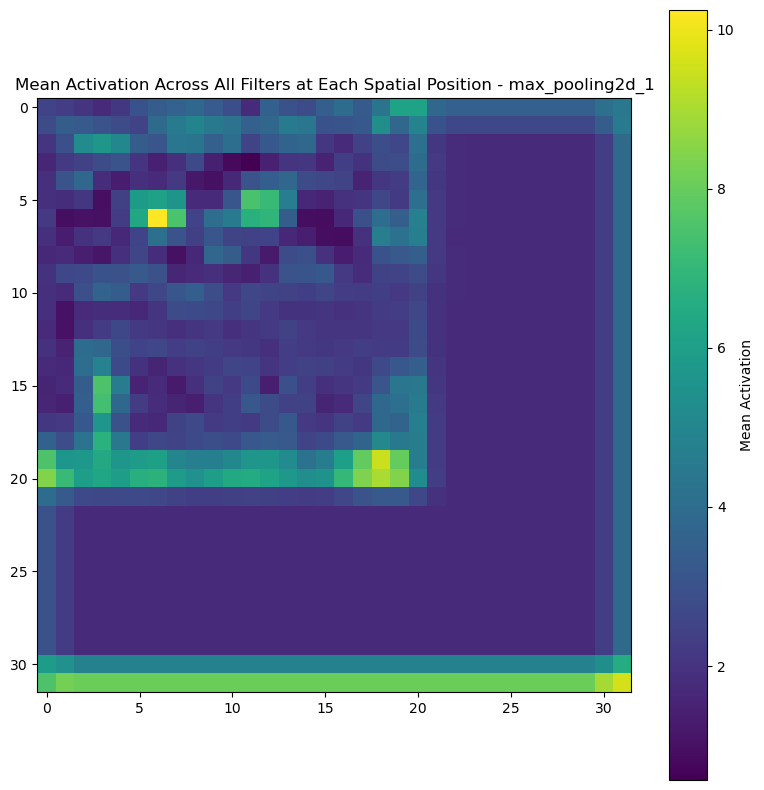

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


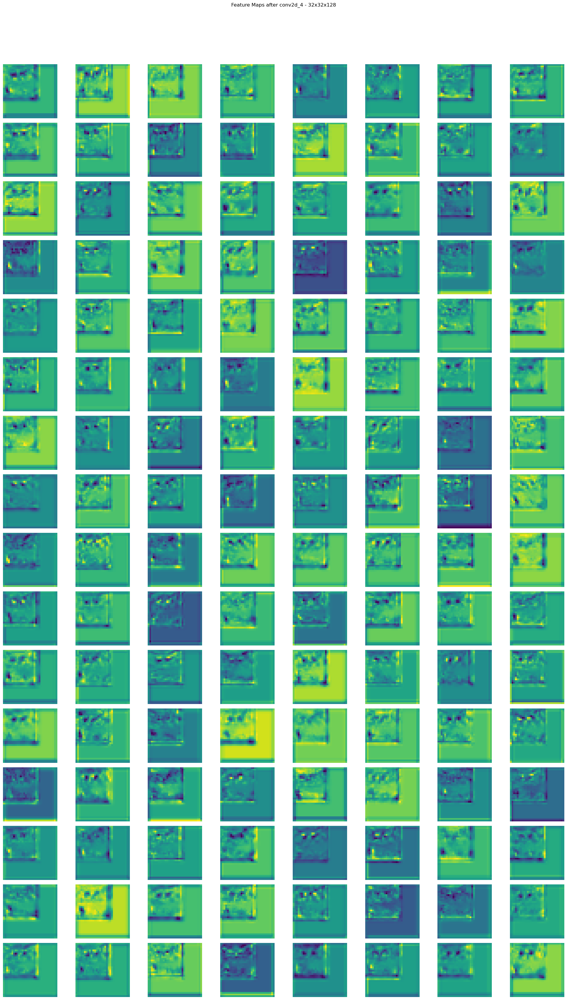

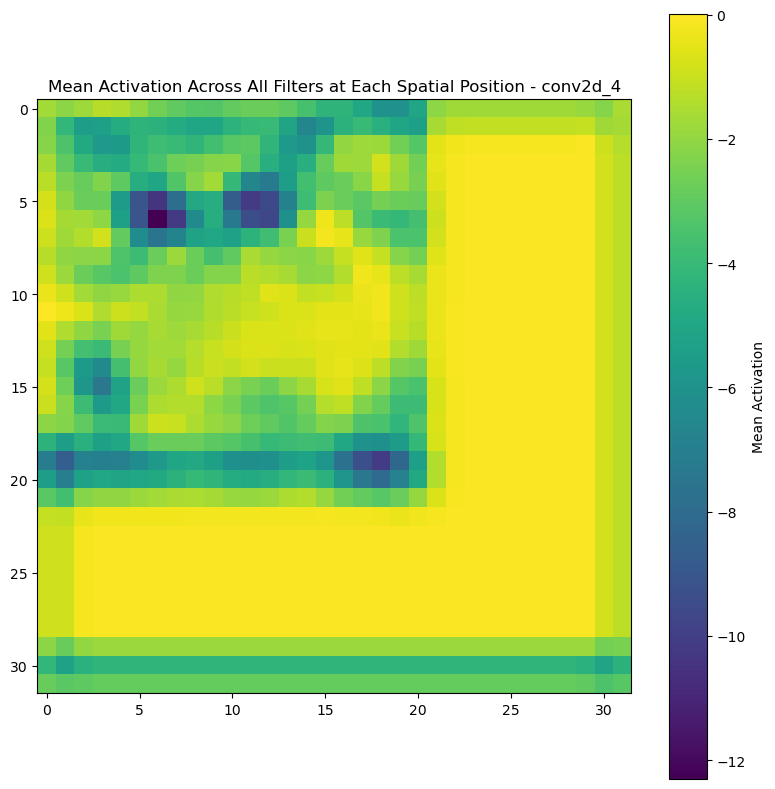

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


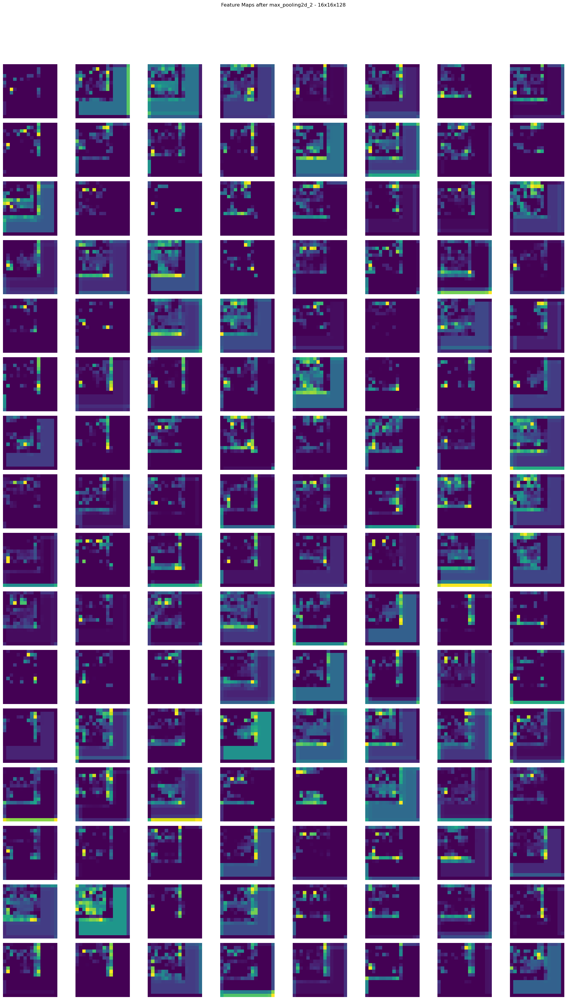

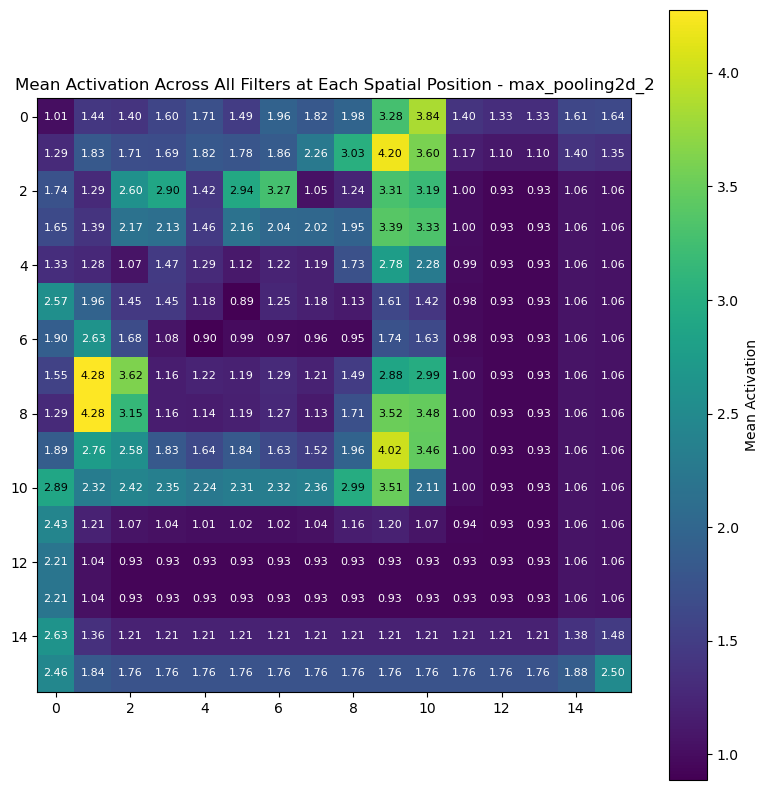

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


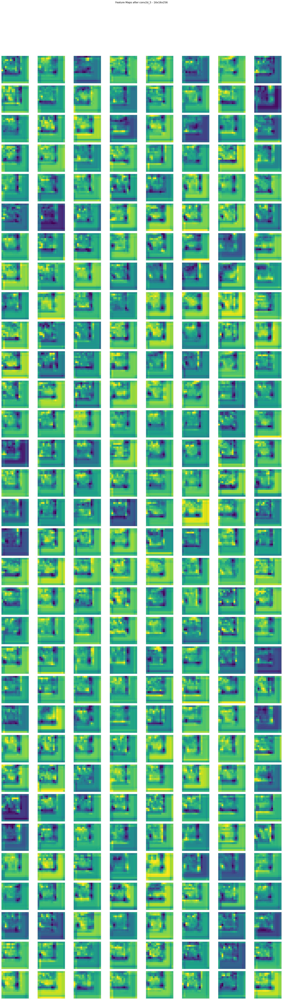

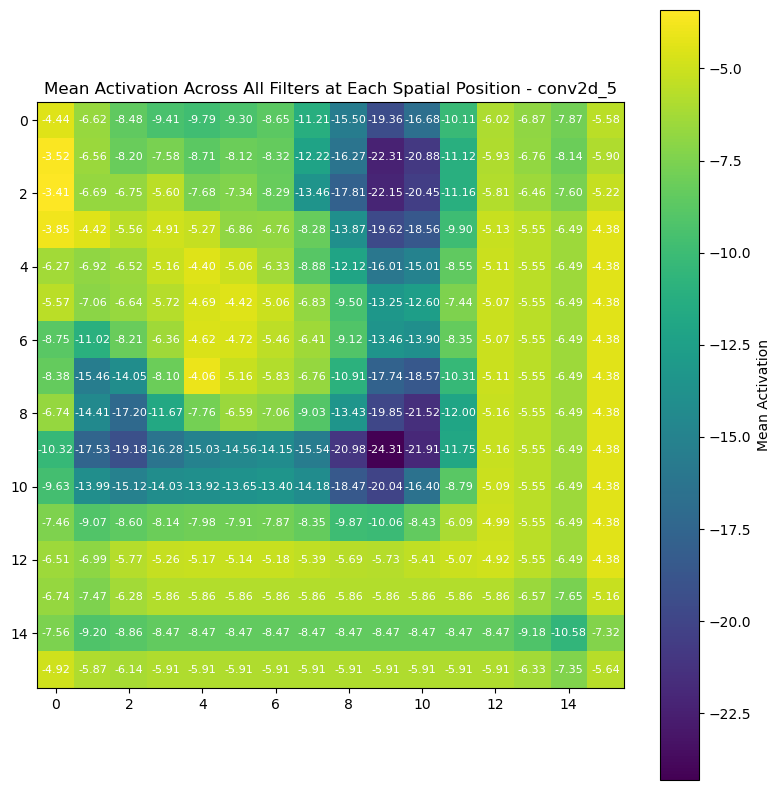

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


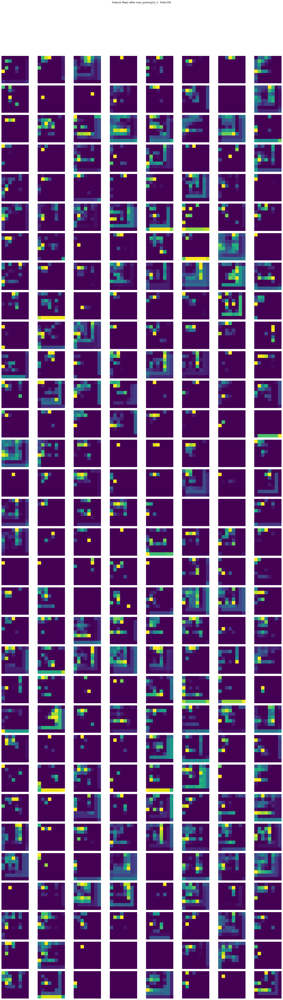

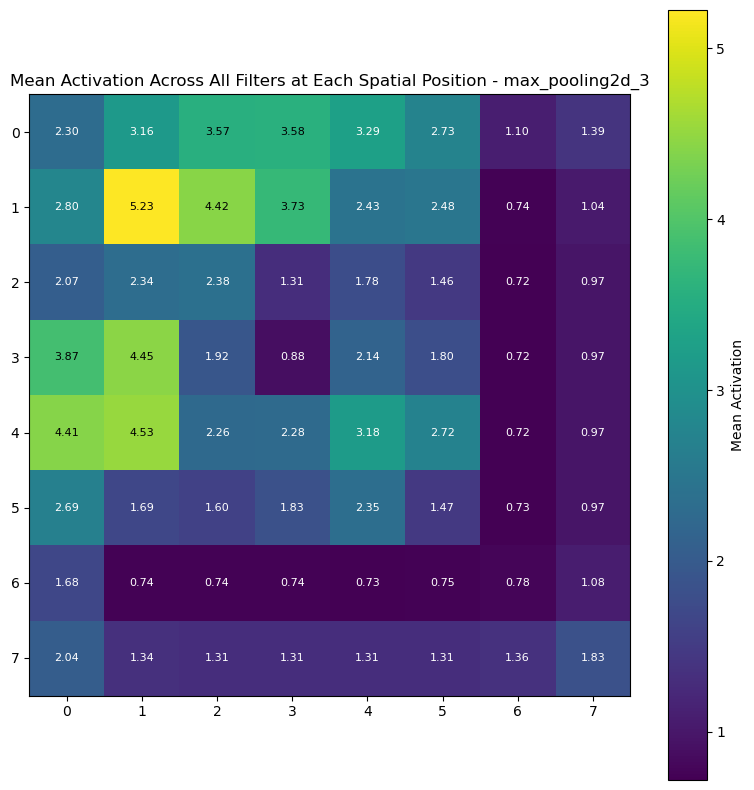

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


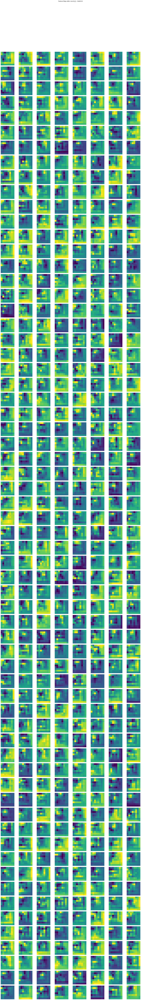

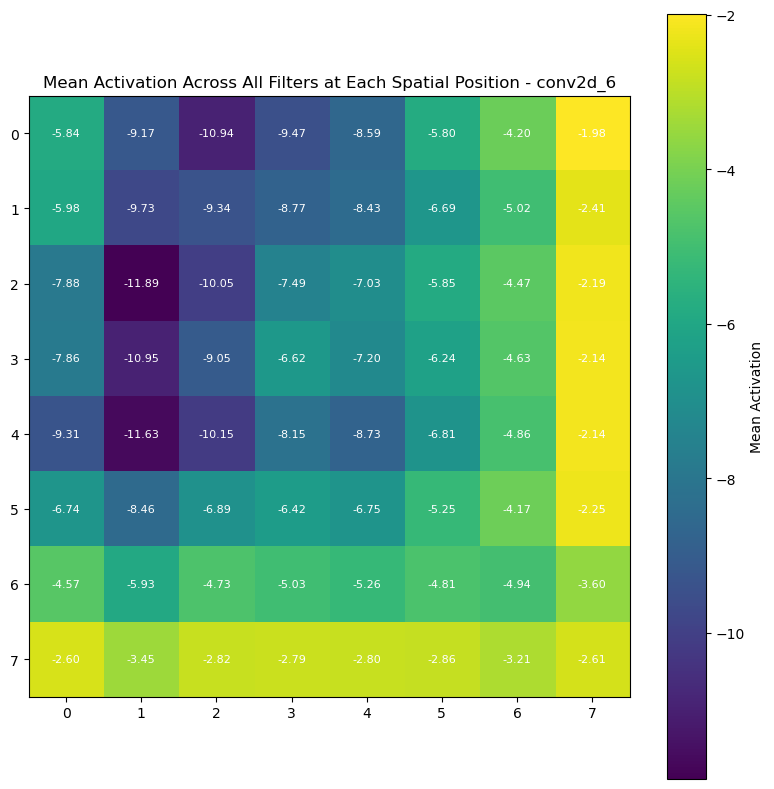

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


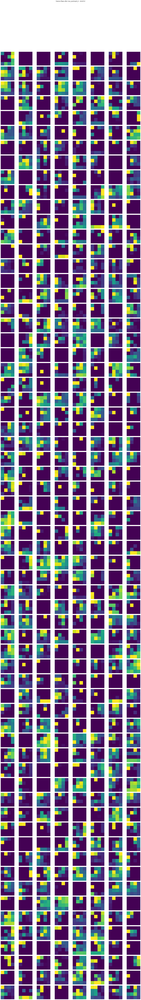

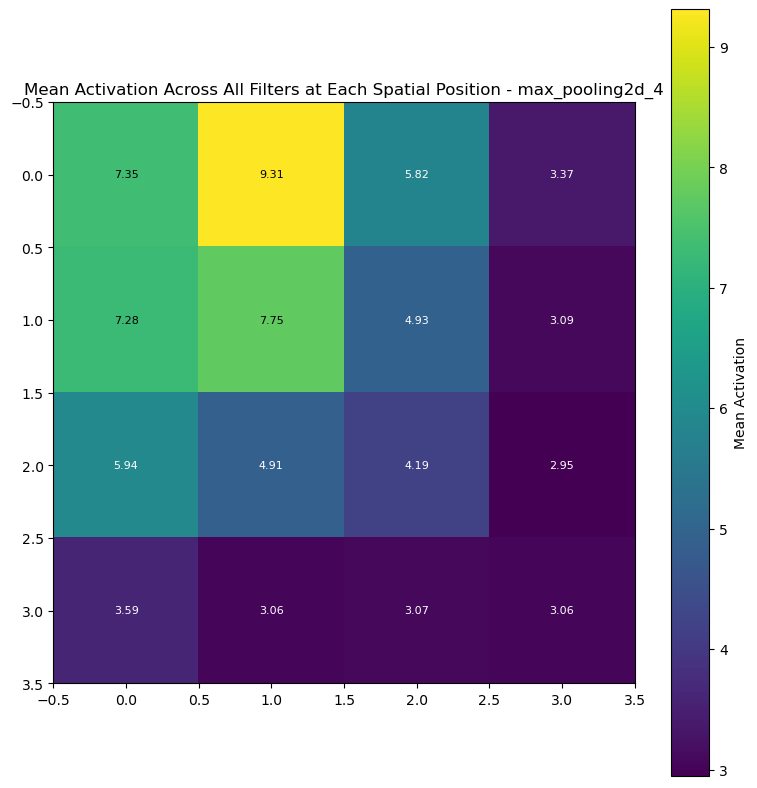

In [15]:
analyze_cnn_layers(model, val_dataset, class_names)


Processing class: cat
  Processing 10 images...
  Processing image 1/10
  Processing image 6/10

Processing class: dog
  Processing 10 images...
  Processing image 1/10
  Processing image 6/10


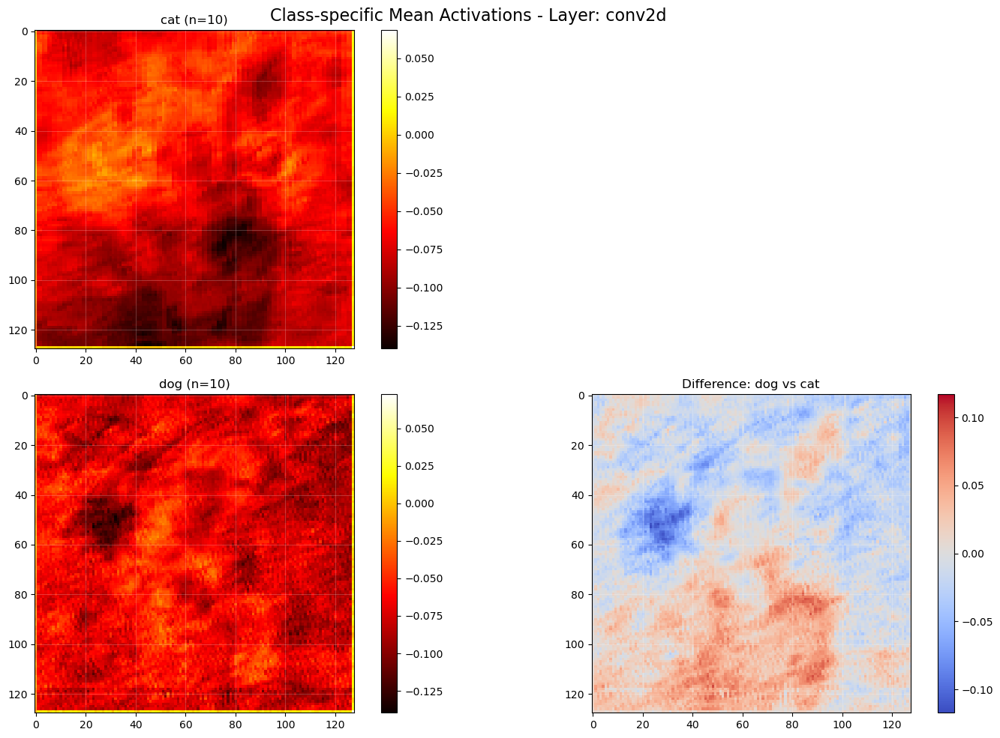

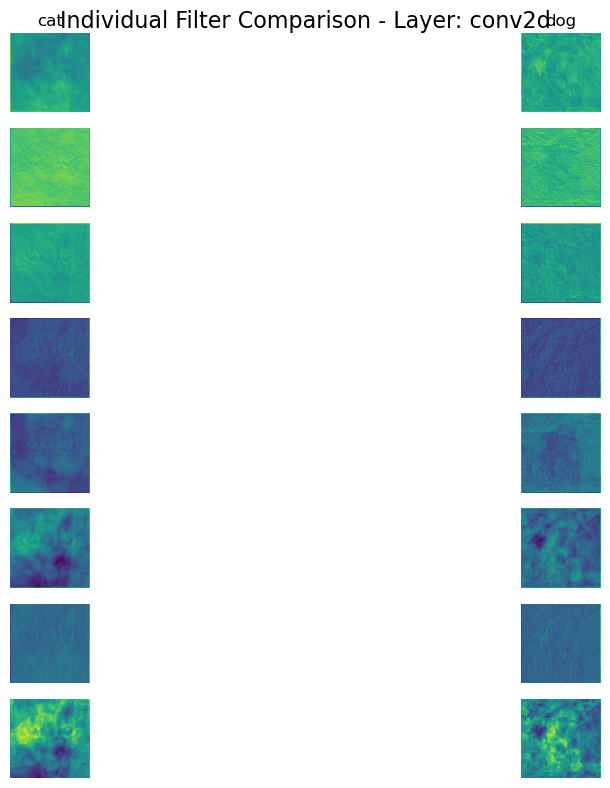

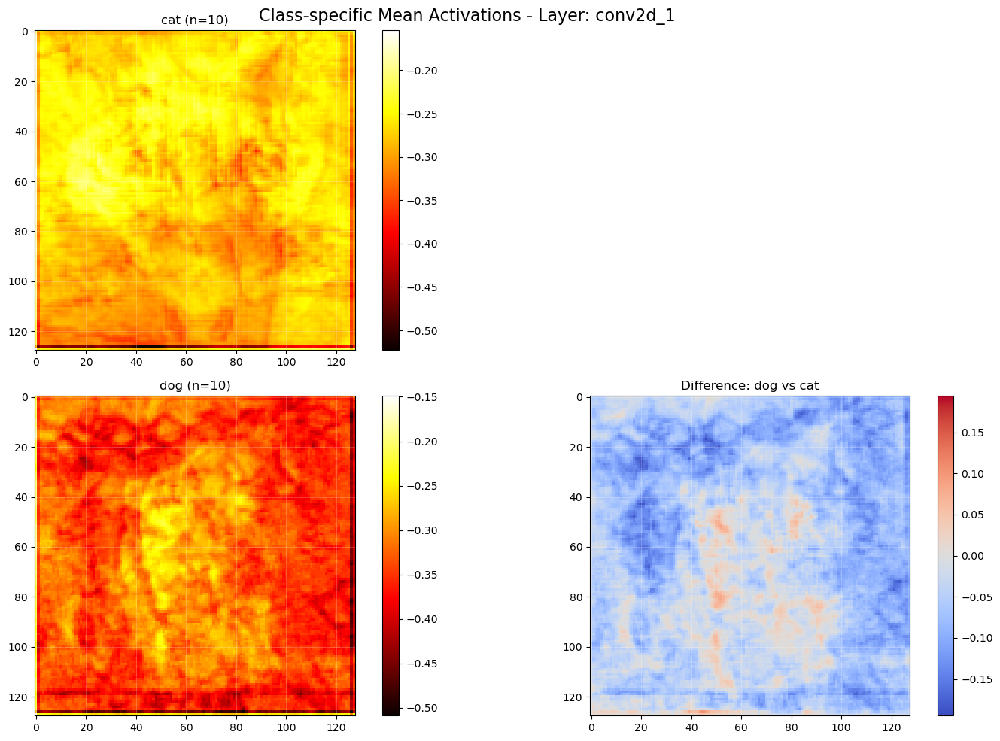

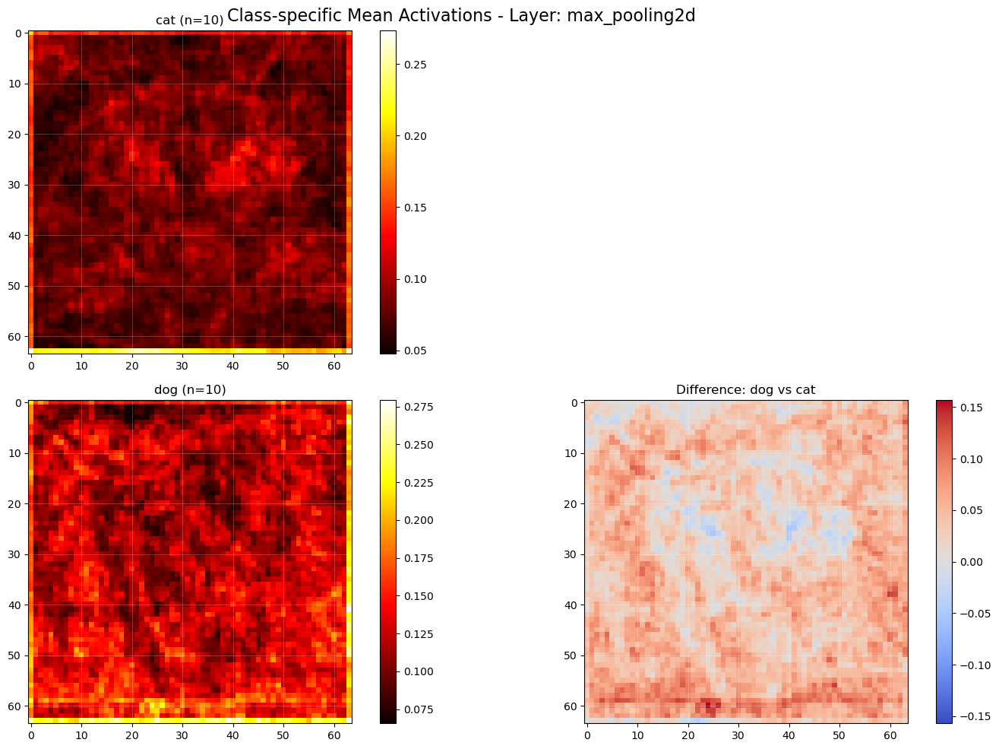

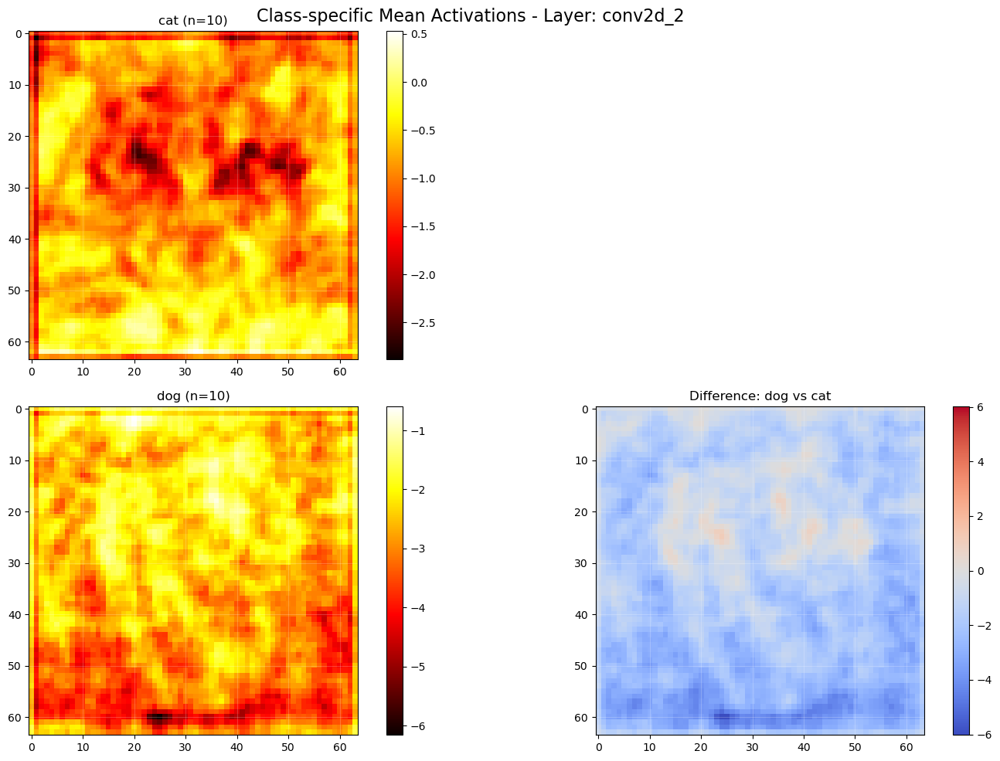

...

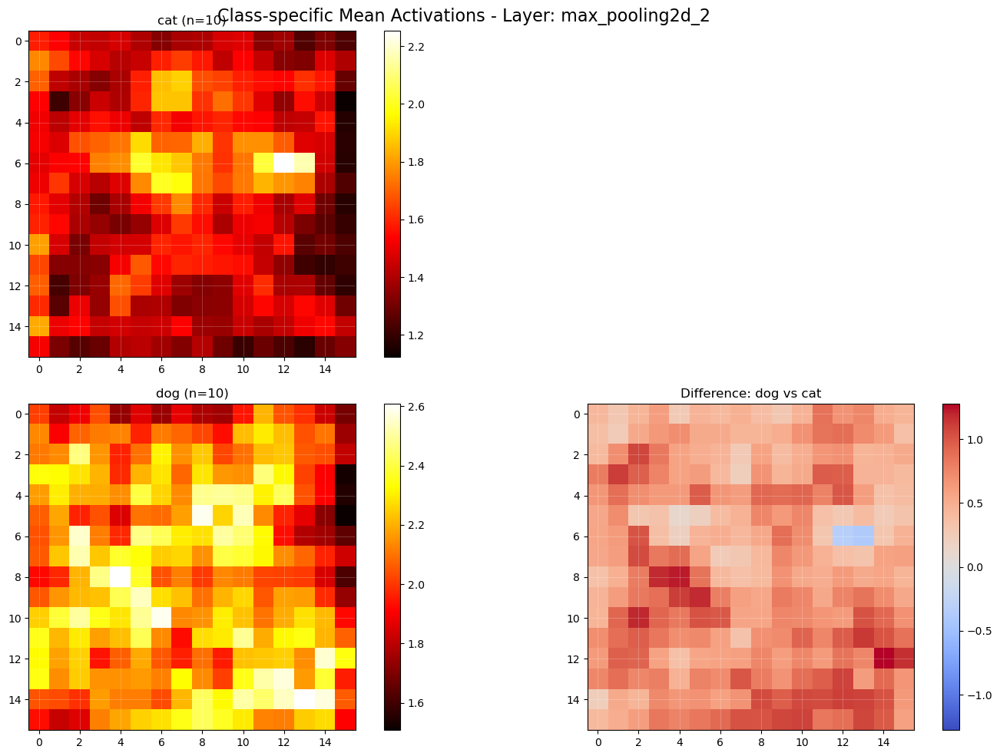

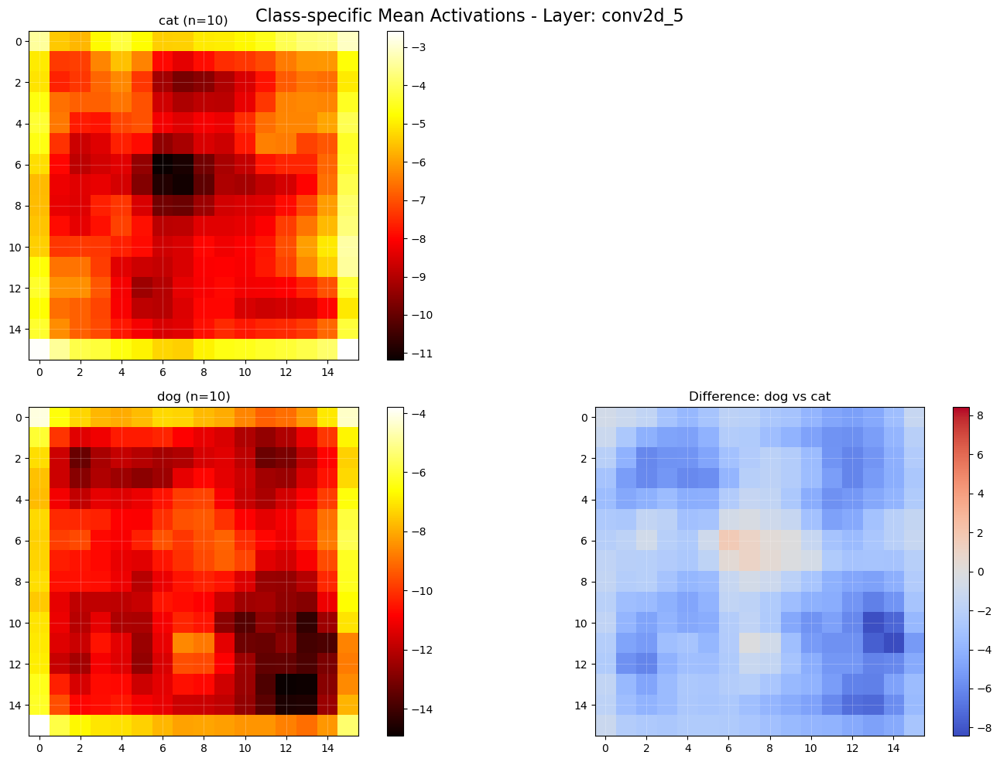

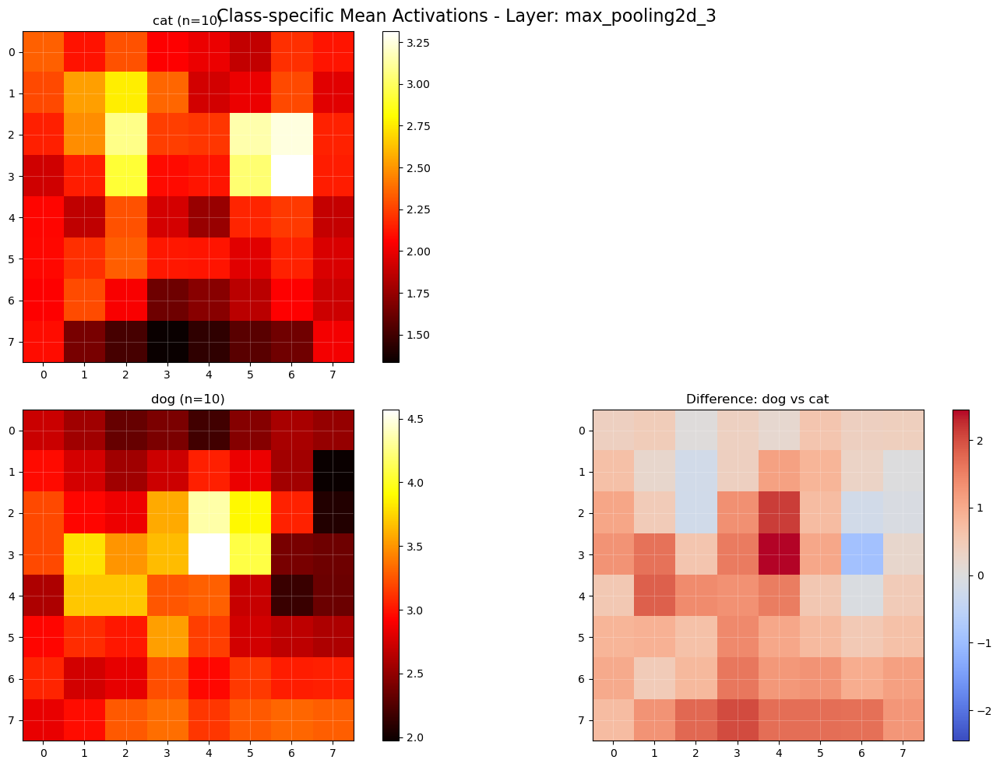

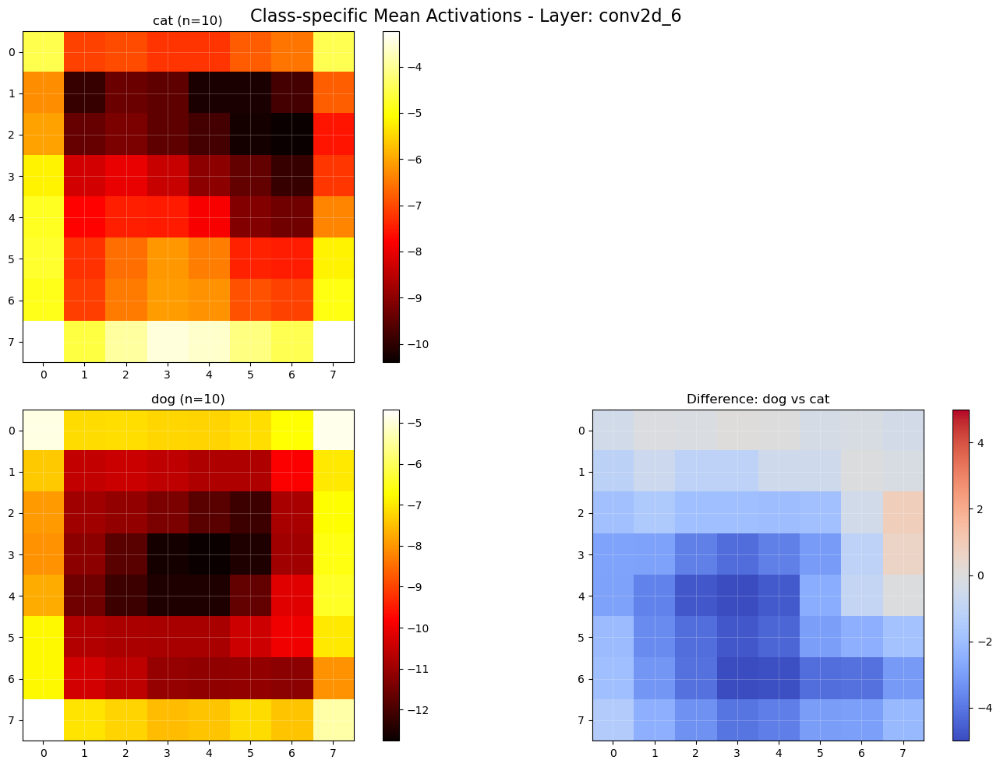

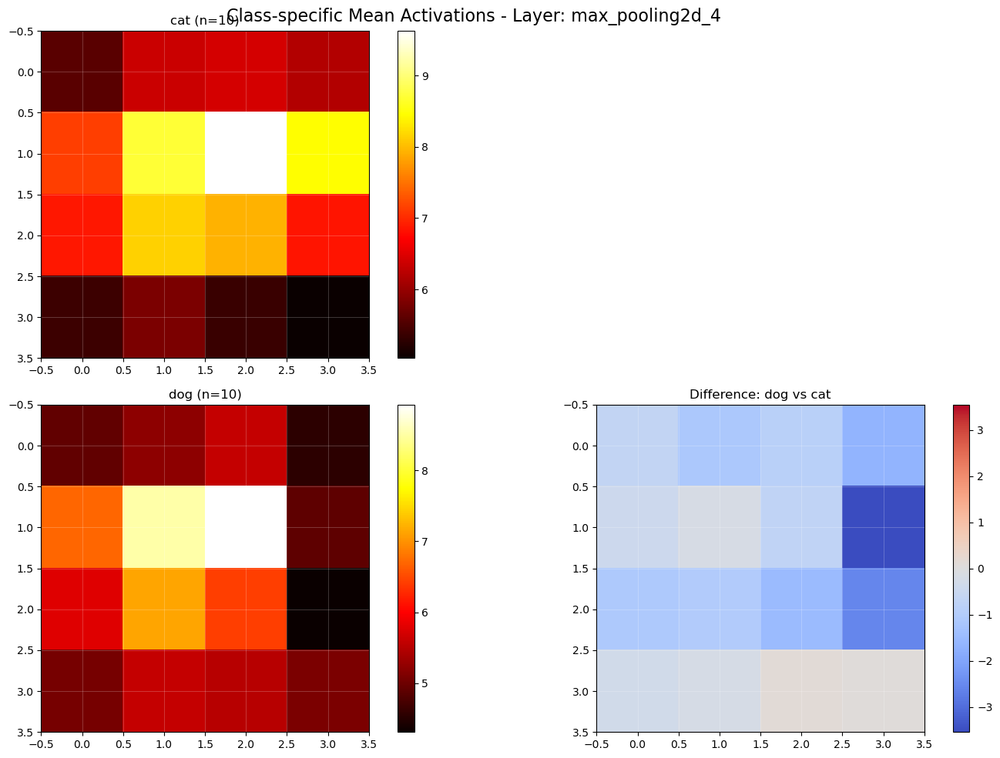

In [24]:
# Define your class folders
class_folders = {
    'cat': './preprocess/test/cat',
    'dog': './preprocess/test/dog'
}

# Call the function with your model
visualize_class_means_from_folders(
    model=model,
    class_folders=class_folders,
    num_per_class=10  # Number of images to sample from each folder
)